In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
import matplotlib.dates as mdates
import time
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

warnings.filterwarnings("ignore")
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', 200)
%matplotlib inline

In [2]:
df=pd.read_pickle('../dataset_/transformed_dataset.pickle')
df.head()

,title,artist,release_type,sub_genre,artist_followers,explicit,album,track_number,tracks_in_album,danceability,energy,key,loudness,mode,speechiness,acoustics,instrumentalness,liveness,valence,tempo,time_signature,genre,duration_min,popularity
0,!,O.S.T.R.,album,polish hip hop,12.634134,False,W drodze po szczęście,1,15,0.561,0.798,1,-7.064,1,0.277632,0.267734,0.000000,-2.207275,0.140,140.837,4,hip hop,1.307256,6.763885
1,!,Trippie Redd,album,melodic rap,15.520695,True,!,1,14,0.725,0.543,5,-6.311,1,0.080750,0.029170,0.000000,-1.731606,0.693,119.961,4,rap,0.813438,7.505795
2,!ill be back!,Rilès,single,french hip hop,13.328738,True,!I'll Be Back!,1,1,0.823,0.612,1,-7.767,1,0.221542,0.155293,0.000000,-2.216407,0.688,142.959,4,hip hop,1.090429,3.903991
3,#%_! dig selv,Artigeardit,album,danish hip hop,9.895506,True,IDIOT,9,16,0.655,0.498,8,-7.297,1,0.256965,0.117783,0.000014,-1.795767,0.241,94.146,4,hip hop,1.142836,6.023569
4,#213,YL,album,francoton,13.332877,True,Vaillants,4,12,0.714,0.727,4,-6.216,0,0.347836,0.182322,0.000000,-2.431555,0.497,190.567,3,indie,1.201515,3.887730


In [3]:
def pca_2d(genre1, genre2):
    # Use dataset with transformed features
    df=pd.read_pickle('../dataset_/transformed_dataset.pickle')
    df= df[df['genre']!='else']
    
    # Scale numeric features
    num = ['popularity', 'artist_followers', 'danceability', 'energy', 'loudness', 'speechiness', 'acoustics','instrumentalness','liveness','valence','tempo', 'duration_min']
    X = num # + ['artist']
    y = ['genre']
    df = df[X + y]
    
    scaler = StandardScaler()

    df[num] = scaler.fit_transform(df[num])
    
    # Create used dataset
    #genres = [genre1,genre2]

    #df = df.loc[df['genre'].isin(genres)]

    #genre1 = df[df['genre'] == genres[0]]
    #genre2 = df[df['genre'] == genres[1]]

    #genre1 = genre1.sample(n=min(genre1.shape[0],genre2.shape[0]), random_state=101)
    #genre2 = genre2.sample(n=genre1.shape[0], random_state=101)

    #df = pd.concat([genre1,genre2])

    ###########################################################################

    # PCA

    #num = ['popularity', 'artist_followers', 'danceability', 'energy', 'loudness', 'speechiness', 'acoustics','instrumentalness','liveness','valence','tempo', 'duration_min']
    #X = num # + ['artist']
    #y = ['genre']
    #df = df[X + y]

    ###########################################################################

    start = time.time()

    pca = PCA()
    components = pca.fit_transform(df[X])

    end = time.time()

    print(str(round(end - start,4)) + ' seconds')

    ###########################################################################

    columns=[f'pc {i}' for i in range(components.shape[1])]
    principalDf = pd.DataFrame(data=components, columns=columns)
    principalDf.reset_index(drop=True, inplace=True)
    y_val = df[y]
    y_val.reset_index(drop=True, inplace=True)
    principalDf= pd.concat([principalDf, y_val], axis=1)
    print(pca.explained_variance_ratio_.cumsum())
    
    genres = [genre1,genre2]

    principalDf = principalDf.loc[principalDf['genre'].isin(genres)]

    genre1 = principalDf[principalDf['genre'] == genres[0]]
    genre2 = principalDf[principalDf['genre'] == genres[1]]

    #genre1 = genre1.sample(n=min(genre1.shape[0],genre2.shape[0]), random_state=101)
    #genre2 = genre2.sample(n=genre1.shape[0], random_state=101)

    principalDf = pd.concat([genre1,genre2])
    
    return principalDf

In [4]:
def tsne_2d(genre1, genre2, perplexity=20):
    # TSNE
    df=pd.read_pickle('../dataset_/transformed_dataset.pickle')
    df= df[df['genre']!='else']
    
    num = ['popularity', 'artist_followers', 'danceability', 'energy', 'loudness', 'speechiness', 'acoustics','instrumentalness','liveness','valence','tempo', 'duration_min']
    X = num # + ['artist']
    y = ['genre']
    df = df[X + y]
    
    scaler = StandardScaler()

    df[num] = scaler.fit_transform(df[num])
    
    genres = [genre1,genre2]

    df = df.loc[df['genre'].isin(genres)]

    genre1 = df[df['genre'] == genres[0]]
    genre2 = df[df['genre'] == genres[1]]

    genre1 = genre1.sample(n=min(genre1.shape[0],genre2.shape[0]), random_state=101)
    genre2 = genre2.sample(n=genre1.shape[0], random_state=101)

    df = pd.concat([genre1,genre2])

    ###########################################################################

    #TSNE

    num = ['popularity', 'artist_followers', 'danceability', 'energy', 'loudness', 'speechiness', 'acoustics','instrumentalness','liveness','valence','tempo', 'duration_min']
    X = num # + ['artist']
    y = ['genre']
    df = df[X + y]

    ###########################################################################

    start = time.time()

    tsne = TSNE(n_components=2, perplexity=perplexity)  # perplexity=40 , perplexity=60
    tsne_result = tsne.fit_transform(df[X])

    end = time.time()
    print(str(round(end - start,4)) + ' seconds')

    ###########################################################################

    columns=[f'tsne comp. {i}' for i in range(tsne_result.shape[1])]
    tsne_Df = pd.DataFrame(data=tsne_result, columns=columns)
    tsne_Df.reset_index(drop=True, inplace=True)
    y_val = df[y]
    y_val.reset_index(drop=True, inplace=True)
    tsne_Df = pd.concat([tsne_Df, y_val], axis=1)

    return tsne_Df

# Numeric Song Features + Popularity + Artist Followers (Scaled)
## PCA

In [5]:
#num = ['popularity', 'artist_followers', 'danceability', 'energy', 'loudness', 'speechiness', 'acoustics','instrumentalness','liveness','valence','tempo', 'duration_min']
#X = num # + ['artist']
#y = ['genre']
#df = df[X + y]

In [6]:
# Normalization

# scaler = MinMaxScaler()
#scaler = StandardScaler()

#df[num] = scaler.fit_transform(df[num])
#df.head()
#scaled_numeric_X_min_max = pd.DataFrame(scaled_numeric_X, columns=numeric_df.columns)
#scaled_numeric_X_min_max.describe()

In [7]:
# Choose your Pokemon
# genres = ['bolero','reggae','jazz','opm']
# genres = ['pop','rock']
# genres = ['country','bolero']

#df = df.loc[df['genre'].isin(genres)]
#df.head()

In [8]:
#start = time.time()

#pca = PCA()
#components = pca.fit_transform(df[X])

#end = time.time()
#print(end - start)

In [9]:
#columns=[f'pc {i}' for i in range(components.shape[1])]
#principalDf = pd.DataFrame(data=components, columns=columns)
#principalDf.reset_index(drop=True, inplace=True)
#y_val = df[y]
#y_val.reset_index(drop=True, inplace=True)
#principalDf= pd.concat([principalDf, y_val], axis=1)
#principalDf

In [10]:
#pca.explained_variance_ratio_

In [11]:
#pca.explained_variance_ratio_.cumsum()

In [12]:
#plt.figure(figsize=(12, 8))
#sns.scatterplot(x=principalDf.iloc[:, 0], y=principalDf.iloc[:, 1], hue=principalDf['genre'])

In [13]:
import plotly.express as px

def plot3d(df3, title, clus_lab):
    """Visual 3d DR method with cluster or labels
    Parameters:
    df3 (Dataframe): name_changed dataframe with descriptor, cluster and labels
    title (string): tiles name
    clus_lab (string): select cluster or labels as keyword 
    """    
    fig = px.scatter_3d(df3, x=df3.iloc[:, 0], y=df3.iloc[:, 1], z=df3.iloc[:, 2],
                        color=clus_lab, title=title, labels=df3.columns[:3],
                        color_discrete_sequence=px.colors.qualitative.Dark24)
    
    fig.update_layout( autosize=False, 
                      width=1000,
                      height=1000, 
                      scene = dict(
                          xaxis_title=df3.columns[0],
                          yaxis_title=df3.columns[1],
                          zaxis_title=df3.columns[2])
                     )
    fig.show()

In [6]:
#principalDf.iloc[:, :3].columns

In [7]:
#plot3d(principalDf.iloc[:, :3], 'Spread of the first 3 PC', principalDf['genre'])

## TSNE

In [16]:
# Try the same with tsne methods

#start = time.time()

#tsne = TSNE(n_components=2, perplexity=50)  # perplexity=40 , perplexity=60
#tsne_result = tsne.fit_transform(df[X])

#end = time.time()
#print(end - start)

In [17]:
#columns=[f'tsne comp. {i}' for i in range(tsne_result.shape[1])]
#tsne_Df = pd.DataFrame(data=tsne_result, columns=columns)
#tsne_Df.reset_index(drop=True, inplace=True)
#y_val = df[y]
#y_val.reset_index(drop=True, inplace=True)
#tsne_Df = pd.concat([tsne_Df, y_val], axis=1)
#tsne_Df

In [18]:
#plt.figure(figsize=(8, 8))
#sns.scatterplot(data=tsne_Df, x='tsne comp. 0', y='tsne comp. 1', hue='genre')

In [19]:
# plot3d(tsne_Df, 'Spread of the first 3 TSNE Components', tsne_Df['genre'])

# Subgenres

## Pop
### PCA

In [8]:
df=pd.read_pickle('../dataset_/transformed_dataset.pickle')

pop = df[df['genre']=='pop']
pop['sub_genre'].value_counts().head(10)

dance pop              2868
finnish dance pop      2138
mandopop                962
pop                     769
italian adult pop       591
c-pop                   560
norwegian pop           510
classic swedish pop     508
colombian pop           480
danish pop              434
Name: sub_genre, dtype: int64

In [9]:
pop.shape[0]

18682

In [10]:
# sub_genres = ['dance pop','finnish dance pop','mandopop','pop','italian adult pop', \
#               'c-pop','norwegian pop','classic swedish pop','colombian pop', 'danish pop']

sub_genres = pop['sub_genre'].value_counts().head(min(10,len(pop['sub_genre'].value_counts().index))).index

pop = pop.loc[df['sub_genre'].isin(sub_genres)]

In [11]:
pop.shape[0]

9820

In [12]:
num = ['popularity', 'artist_followers', 'danceability', 'energy', 'loudness', 'speechiness', 'acoustics','instrumentalness','liveness','valence','tempo', 'duration_min']
X = num # + ['artist']
y = ['sub_genre']
pop = pop[X + y]

In [13]:
# scaler = MinMaxScaler()
scaler = StandardScaler()

pop[num] = scaler.fit_transform(pop[num])
pop.head()

,popularity,artist_followers,danceability,energy,loudness,speechiness,acoustics,instrumentalness,liveness,valence,tempo,duration_min,sub_genre
9,-0.997496,-0.096480,1.339632,0.036381,-0.091456,2.011463,-0.532912,-0.116455,0.699349,-1.699651,1.260660,-0.034009,finnish dance pop
25,0.869057,0.571847,0.507230,0.300179,0.842974,-0.738036,-0.874171,-0.128630,-0.110538,0.153898,-0.640400,-0.619814,dance pop
26,-2.200761,-0.497214,1.001028,0.951598,0.678146,-0.372022,-0.492170,-0.132400,-0.199984,0.437329,0.135521,0.194609,finnish dance pop
27,1.295774,-0.497214,1.022191,1.037736,0.945588,-0.387089,-0.551126,-0.132400,2.521918,0.450826,0.135345,0.274668,finnish dance pop
37,1.401302,0.564975,1.184438,1.086188,1.210202,-0.343302,-0.519295,-0.132400,-0.098146,1.476576,-0.815432,0.426686,dance pop


In [14]:
start = time.time()

pca = PCA()
components = pca.fit_transform(pop[X])

end = time.time()
print(end - start)

0.051856279373168945


In [15]:
columns=[f'pc {i}' for i in range(components.shape[1])]
principalDf = pd.DataFrame(data=components, columns=columns)
principalDf.reset_index(drop=True, inplace=True)
y_val = pop[y]
y_val.reset_index(drop=True, inplace=True)
principalDf= pd.concat([principalDf, y_val], axis=1)
principalDf

,pc 0,pc 1,pc 2,pc 3,pc 4,pc 5,pc 6,pc 7,pc 8,pc 9,pc 10,pc 11,sub_genre
0,-0.366051,0.720473,1.238255,-1.327030,0.243153,-0.232385,1.331002,0.829471,-0.693427,1.842024,-1.305419,0.149630,finnish dance pop
1,-1.228183,-0.310663,-1.136272,0.596530,0.210422,-0.080591,-0.545913,0.358623,0.650593,0.247685,0.052426,-0.281405,dance pop
2,-1.145147,-0.350231,1.440973,1.081788,-1.054271,0.477527,1.144773,-0.442379,0.438478,0.412602,-0.435128,0.255816,finnish dance pop
3,-1.927263,-0.718667,0.262141,0.099185,0.858300,-1.813871,-1.376827,-0.850698,-0.613883,0.536686,-0.657807,0.131226,finnish dance pop
4,-2.295321,-0.419418,-1.577586,0.732948,-0.134327,-0.044343,-0.539699,-0.713730,-0.596439,-0.352075,0.004246,0.035705,dance pop
...,...,...,...,...,...,...,...,...,...,...,...,...,...
9815,4.378121,-1.290824,0.379110,-1.219205,0.876733,-1.287284,-0.350193,-0.348893,-0.328697,-0.350006,0.260987,0.121759,c-pop
9816,2.711228,-0.964758,-0.284046,-0.721753,0.257788,-0.687171,-0.484256,-1.279828,-0.624377,-0.942757,0.300716,0.056009,mandopop
9817,2.875792,-0.944164,0.615256,-0.296983,-0.059835,-0.582438,0.574318,-1.439731,-0.176038,-0.864802,0.250609,0.023809,mandopop
9818,2.313419,-0.718131,0.818061,0.086165,-0.558907,0.173795,-0.505947,0.245343,-0.397354,0.383111,0.458884,-0.225241,c-pop


In [16]:
pca.explained_variance_ratio_

array([0.25042831, 0.11209594, 0.10264006, 0.08739829, 0.0847054 ,
       0.08268419, 0.07010109, 0.0610787 , 0.05756638, 0.04324658,
       0.03344493, 0.01461013])

In [17]:
pca.explained_variance_ratio_.cumsum()

array([0.25042831, 0.36252425, 0.46516431, 0.5525626 , 0.637268  ,
       0.71995219, 0.79005328, 0.85113198, 0.90869836, 0.95194494,
       0.98538987, 1.        ])

<AxesSubplot:xlabel='pc 0', ylabel='pc 1'>

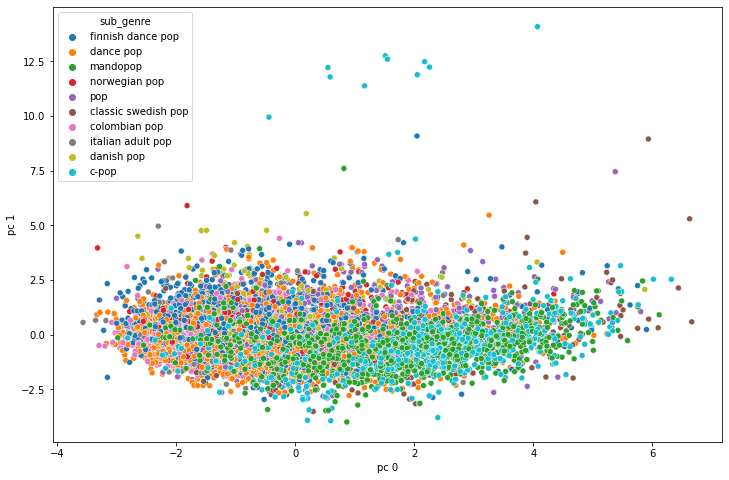

In [18]:
plt.figure(figsize=(12, 8))
sns.scatterplot(x=principalDf.iloc[:, 0], y=principalDf.iloc[:, 1], hue=principalDf['sub_genre'])

In [19]:
principalDf.iloc[:, :3].columns

Index(['pc 0', 'pc 1', 'pc 2'], dtype='object')

In [20]:
plot3d(principalDf.iloc[:, :3], 'Spread of the first 3 PC', principalDf['sub_genre'])

### TSNE

In [33]:
start = time.time()

tsne = TSNE(n_components=2, perplexity=40)  # perplexity=40 was kind of interesting; 300/500 as well but it took 72 sec/2 min
tsne_result = tsne.fit_transform(pop[X])

end = time.time()
print(end - start)

25.900368452072144


In [34]:
columns=[f'tsne comp. {i}' for i in range(tsne_result.shape[1])]
tsne_Df = pd.DataFrame(data=tsne_result, columns=columns)
tsne_Df.reset_index(drop=True, inplace=True)
y_val = pop[y]
y_val.reset_index(drop=True, inplace=True)
tsne_Df = pd.concat([tsne_Df, y_val], axis=1)
tsne_Df

,tsne comp. 0,tsne comp. 1,sub_genre
0,52.672108,40.391159,finnish dance pop
1,-6.439291,34.825699,dance pop
2,29.427671,-37.290096,finnish dance pop
3,54.845844,4.441457,finnish dance pop
4,-6.323997,45.793629,dance pop
...,...,...,...
9815,-55.702030,-34.040413,c-pop
9816,-51.372719,-35.005127,mandopop
9817,-51.015766,-30.951897,mandopop
9818,-24.463314,-41.316471,c-pop


<AxesSubplot:xlabel='tsne comp. 0', ylabel='tsne comp. 1'>

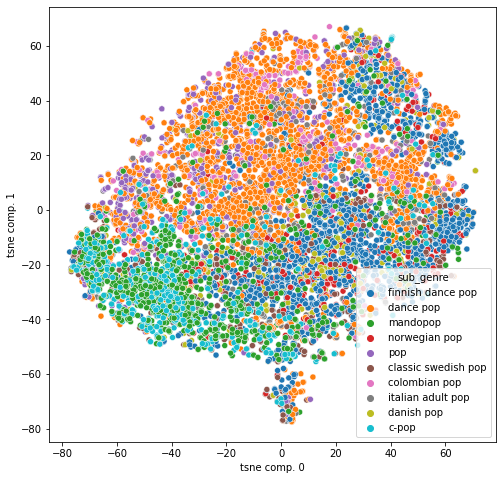

In [35]:
plt.figure(figsize=(8, 8))
sns.scatterplot(data=tsne_Df, x='tsne comp. 0', y='tsne comp. 1', hue='sub_genre')

In [6]:
palette = {"hip hop":"#f77189", 'rap':'#f7754f', 'indie':'#dc8932', \
           'pop':'#c39532', 'latin':'#ae9d31', 'k-pop':'#97a431', \
           'r&b/soul':'#77ab31', 'reggaeton':'#31b33e', 'country':'#33b07a', \
           'rock':'#35ae93', 'dance/electronic':'#37ada4', 'jazz':'#37abb4', \
           'funk':'#38a9c5', 'opm':'#3aa5df', 'house':'#6e9bf4', \
           'boy band':'#a48cf4', 'metal':'#cc7af4', 'trap':'#f45cf2', \
           'bolero':'#f565cc', 'reggae':'#f66bad'}
hue_order = ["hip hop", 'rap', 'indie', \
           'pop', 'latin', 'k-pop', \
           'r&b/soul', 'reggaeton', 'country', \
           'rock', 'dance/electronic', 'jazz', \
           'funk', 'opm', 'house', \
           'boy band', 'metal', 'trap', \
           'bolero', 'reggae']

0.013 seconds
[0.20898871 0.3325267  0.43367713 0.52263439 0.60652504 0.68922418
 0.76270632 0.82787879 0.88913286 0.9417725  0.98193926 1.        ]


(-4.5, 12.0)

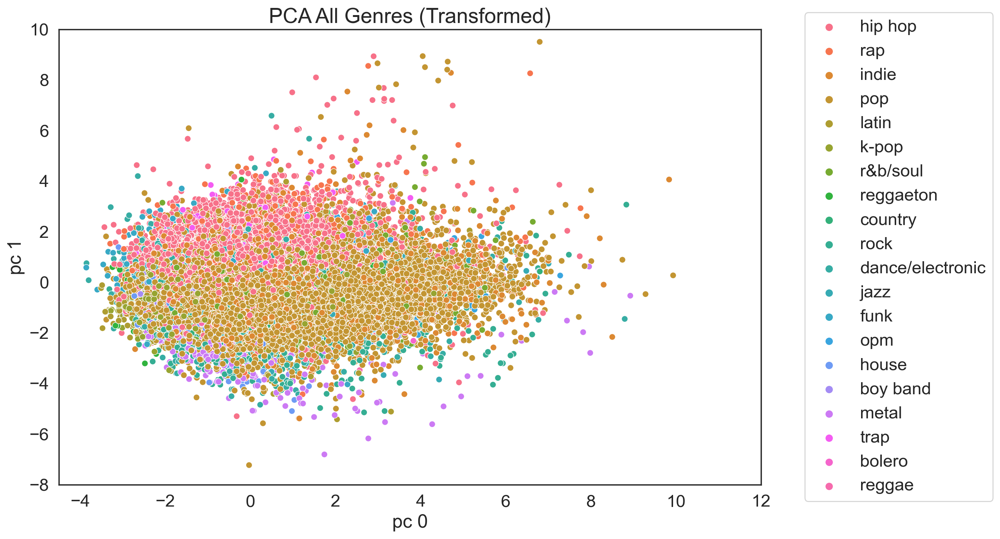

In [63]:
# TODO: all genres PCA
# Use dataset with transformed features
df=pd.read_pickle('../dataset_/transformed_dataset.pickle')
df= df[df['genre']!='else']
    
# Scale numeric features
num = ['popularity', 'artist_followers', 'danceability', 'energy', 'loudness', 'speechiness', 'acoustics','instrumentalness','liveness','valence','tempo', 'duration_min']
X = num # + ['artist']
y = ['genre']
df = df[X + y]
    
scaler = StandardScaler()

df[num] = scaler.fit_transform(df[num])

start = time.time()

pca = PCA()
components = pca.fit_transform(df[X])

end = time.time()

print(str(round(end - start,4)) + ' seconds')

###########################################################################

columns=[f'pc {i}' for i in range(components.shape[1])]
principalDf = pd.DataFrame(data=components, columns=columns)
principalDf.reset_index(drop=True, inplace=True)
y_val = df[y]
y_val.reset_index(drop=True, inplace=True)
principalDf= pd.concat([principalDf, y_val], axis=1)
print(pca.explained_variance_ratio_.cumsum())


plt.figure(figsize=(12, 8),dpi=200)
sns.set_theme(font_scale=1.5,style='white')
ax = sns.scatterplot(x=principalDf.iloc[:, 0], y=principalDf.iloc[:, 1], hue=principalDf['genre'], palette=palette,hue_order=hue_order) # ,  palette=palette
ax.legend(loc='center left', bbox_to_anchor=(1.05, 0.5), ncol=1)
plt.title("PCA All Genres (Transformed)", fontsize=20)
plt.ylim([-8,10])
plt.xlim([-4.5,12])

# Main Genres
## Pop
Subgenres according to the internet:
* k-pop
* boyband (since it is very similar to k-pop)

### k-pop vs boyband

0.014 seconds
[0.20898871 0.3325267  0.43367713 0.52263439 0.60652504 0.68922418
 0.76270632 0.82787879 0.88913286 0.9417725  0.98193926 1.        ]


(-4.5, 12.0)

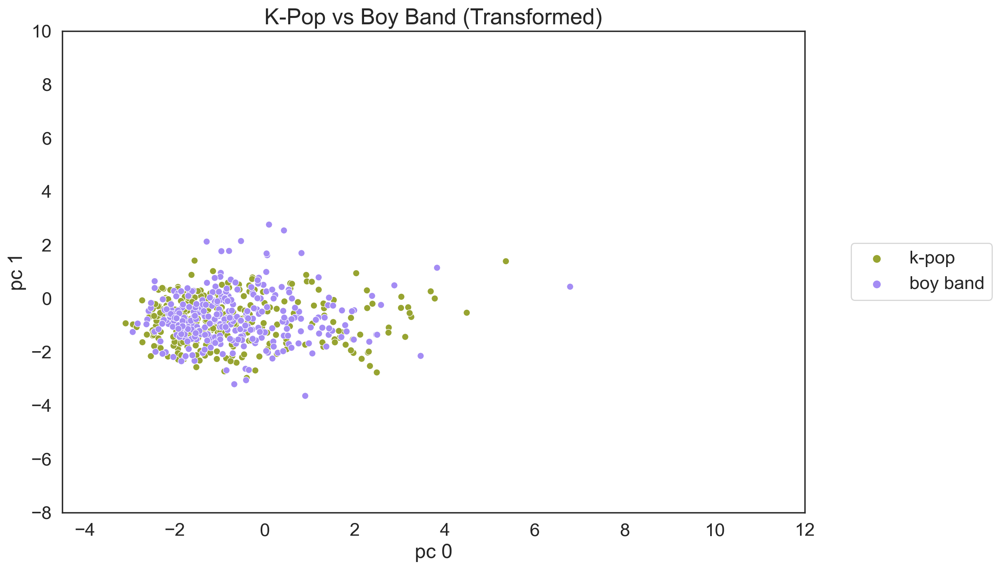

In [60]:
principalDf = pca_2d('k-pop','boy band')

hue_order = ['k-pop', 'boy band']

plt.figure(figsize=(12, 8),dpi=200)
sns.set_theme(font_scale=1.5,style='white')
ax = sns.scatterplot(x=principalDf.iloc[:, 0], y=principalDf.iloc[:, 1], hue=principalDf['genre'], palette=palette,hue_order=hue_order) # ,  palette=palette
ax.legend(loc='center left', bbox_to_anchor=(1.05, 0.5), ncol=1)
plt.title("K-Pop vs Boy Band (Transformed)", fontsize=20)
plt.ylim([-8,10])
plt.xlim([-4.5,12])

In [37]:
plot3d(principalDf.iloc[:, :3], 'Spread of the first 3 PC', principalDf['genre'])

0.756 seconds


<AxesSubplot:xlabel='tsne comp. 0', ylabel='tsne comp. 1'>

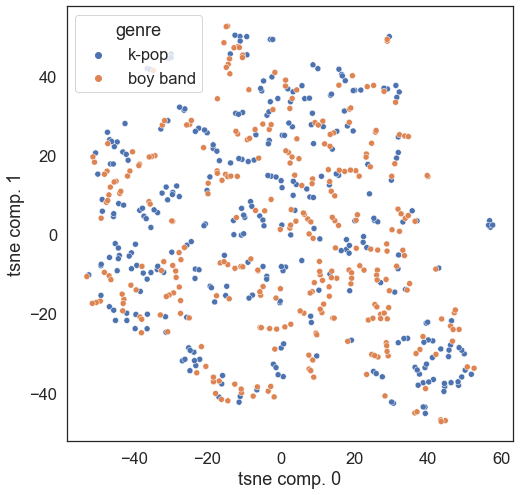

In [42]:
tsne_Df = tsne_2d('k-pop','boy band',10)
plt.figure(figsize=(8, 8))
sns.scatterplot(data=tsne_Df, x='tsne comp. 0', y='tsne comp. 1', hue='genre')

### pop vs k-pop

0.013 seconds
[0.20898871 0.3325267  0.43367713 0.52263439 0.60652504 0.68922418
 0.76270632 0.82787879 0.88913286 0.9417725  0.98193926 1.        ]


(-4.5, 12.0)

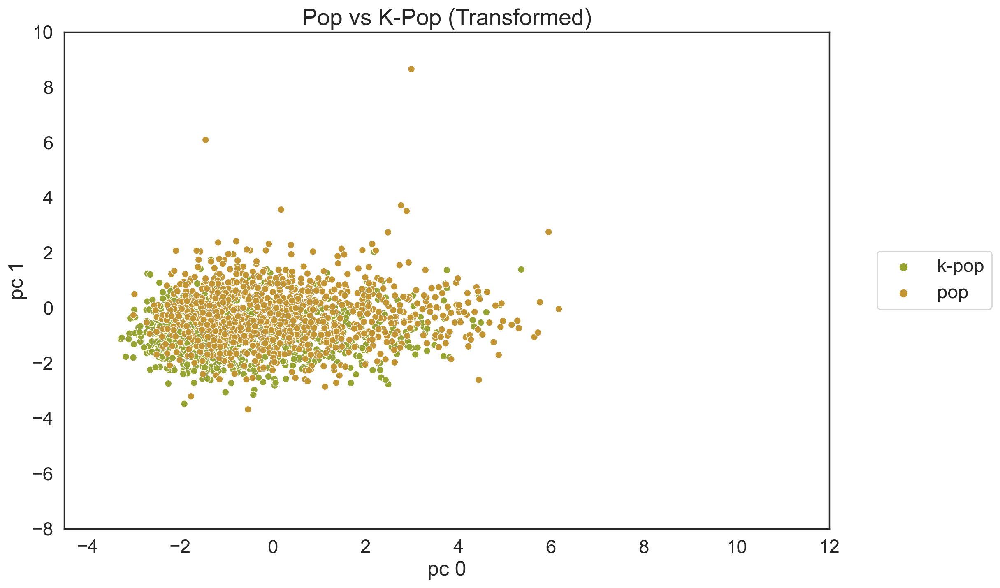

In [59]:
principalDf = pca_2d('k-pop','pop')

hue_order = ['k-pop','pop']

plt.figure(figsize=(12, 8),dpi=200)
sns.set_theme(font_scale=1.5,style='white')
ax = sns.scatterplot(x=principalDf.iloc[:, 0], y=principalDf.iloc[:, 1], hue=principalDf['genre'], palette=palette,hue_order=hue_order) # ,  palette=palette
ax.legend(loc='center left', bbox_to_anchor=(1.05, 0.5), ncol=1)
plt.title("Pop vs K-Pop (Transformed)", fontsize=20)
plt.ylim([-8,10])
plt.xlim([-4.5,12])

#plt.figure(figsize=(12, 8))
#sns.scatterplot(x=principalDf.iloc[:, 0], y=principalDf.iloc[:, 1], hue=principalDf['genre'])

In [40]:
plot3d(principalDf.iloc[:, :3], 'Spread of the first 3 PC', principalDf['genre'])

4.4419 seconds


<AxesSubplot:xlabel='tsne comp. 0', ylabel='tsne comp. 1'>

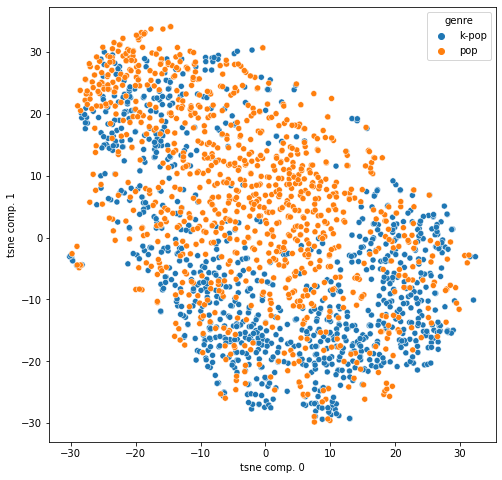

In [41]:
tsne_Df = tsne_2d('k-pop','pop',60)
plt.figure(figsize=(8, 8))
sns.scatterplot(data=tsne_Df, x='tsne comp. 0', y='tsne comp. 1', hue='genre')

## Rock
Subgenres according to the internet:
* metal
* indie

### rock vs metal

0.013 seconds
[0.20898871 0.3325267  0.43367713 0.52263439 0.60652504 0.68922418
 0.76270632 0.82787879 0.88913286 0.9417725  0.98193926 1.        ]


(-4.5, 12.0)

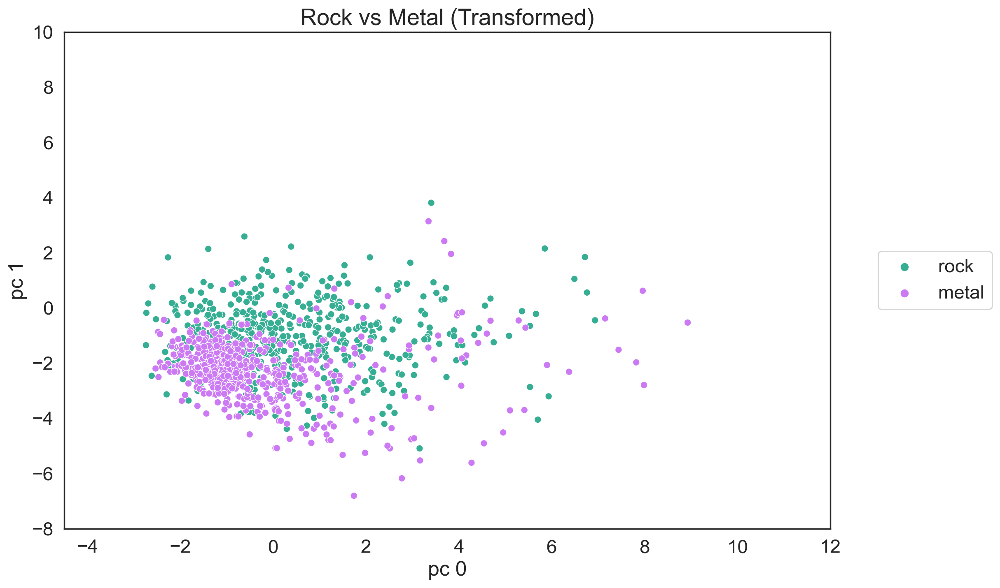

In [56]:
principalDf = pca_2d('rock','metal')

hue_order = ['rock', 'metal']

plt.figure(figsize=(12, 8),dpi=200)
sns.set_theme(font_scale=1.5,style='white')
ax = sns.scatterplot(x=principalDf.iloc[:, 0], y=principalDf.iloc[:, 1], hue=principalDf['genre'], palette=palette,hue_order=hue_order) # ,  palette=palette
ax.legend(loc='center left', bbox_to_anchor=(1.05, 0.5), ncol=1)
plt.title("Rock vs Metal (Transformed)", fontsize=20)
plt.ylim([-8,10])
plt.xlim([-4.5,12])

#plt.figure(figsize=(12, 8))
#sns.scatterplot(x=principalDf.iloc[:, 0], y=principalDf.iloc[:, 1], hue=principalDf['genre'])

In [43]:
plot3d(principalDf.iloc[:, :3], 'Spread of the first 3 PC', principalDf['genre'])

2.2275 seconds


<AxesSubplot:xlabel='tsne comp. 0', ylabel='tsne comp. 1'>

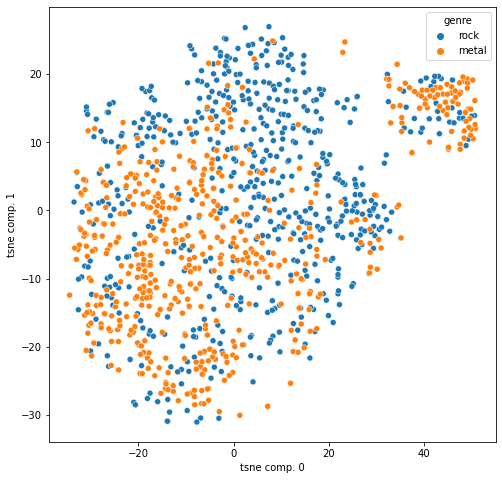

In [44]:
tsne_Df = tsne_2d('rock','metal',40)
plt.figure(figsize=(8, 8))
sns.scatterplot(data=tsne_Df, x='tsne comp. 0', y='tsne comp. 1', hue='genre')

### rock vs indie

0.015 seconds
[0.20898871 0.3325267  0.43367713 0.52263439 0.60652504 0.68922418
 0.76270632 0.82787879 0.88913286 0.9417725  0.98193926 1.        ]


(-4.5, 12.0)

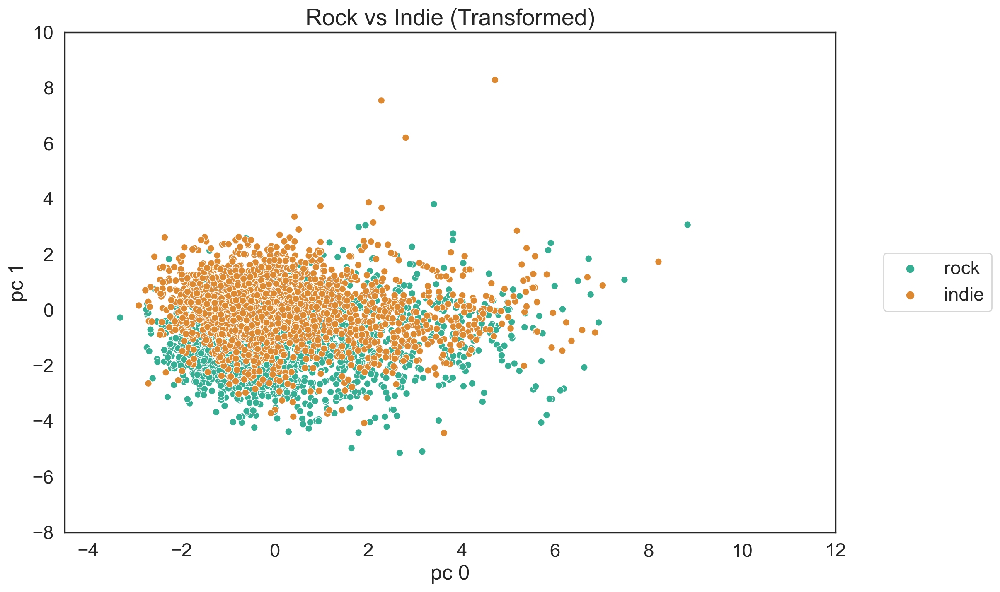

In [57]:
principalDf = pca_2d('rock','indie')

hue_order = ['rock', 'indie']

plt.figure(figsize=(12, 8),dpi=200)
sns.set_theme(font_scale=1.5,style='white')
ax = sns.scatterplot(x=principalDf.iloc[:, 0], y=principalDf.iloc[:, 1], hue=principalDf['genre'], palette=palette,hue_order=hue_order) # ,  palette=palette
ax.legend(loc='center left', bbox_to_anchor=(1.05, 0.5), ncol=1)
plt.title("Rock vs Indie (Transformed)", fontsize=20)
plt.ylim([-8,10])
plt.xlim([-4.5,12])

#plt.figure(figsize=(12, 8))
#sns.scatterplot(x=principalDf.iloc[:, 0], y=principalDf.iloc[:, 1], hue=principalDf['genre'])

In [54]:
plot3d(principalDf.iloc[:, :3], 'Spread of the first 3 PC', principalDf['genre'])

7.5285 seconds


<AxesSubplot:xlabel='tsne comp. 0', ylabel='tsne comp. 1'>

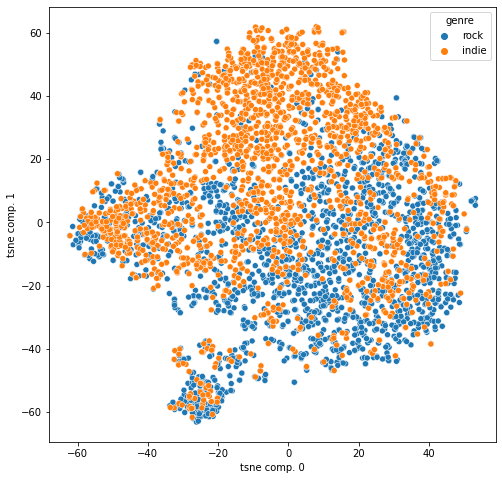

In [47]:
tsne_Df = tsne_2d('rock','indie',40)
plt.figure(figsize=(8, 8))
sns.scatterplot(data=tsne_Df, x='tsne comp. 0', y='tsne comp. 1', hue='genre')

## Hip Hop
Subgenres according to the internet:
* rap

### hip hop vs rap

0.0141 seconds
[0.20898871 0.3325267  0.43367713 0.52263439 0.60652504 0.68922418
 0.76270632 0.82787879 0.88913286 0.9417725  0.98193926 1.        ]


(-4.5, 12.0)

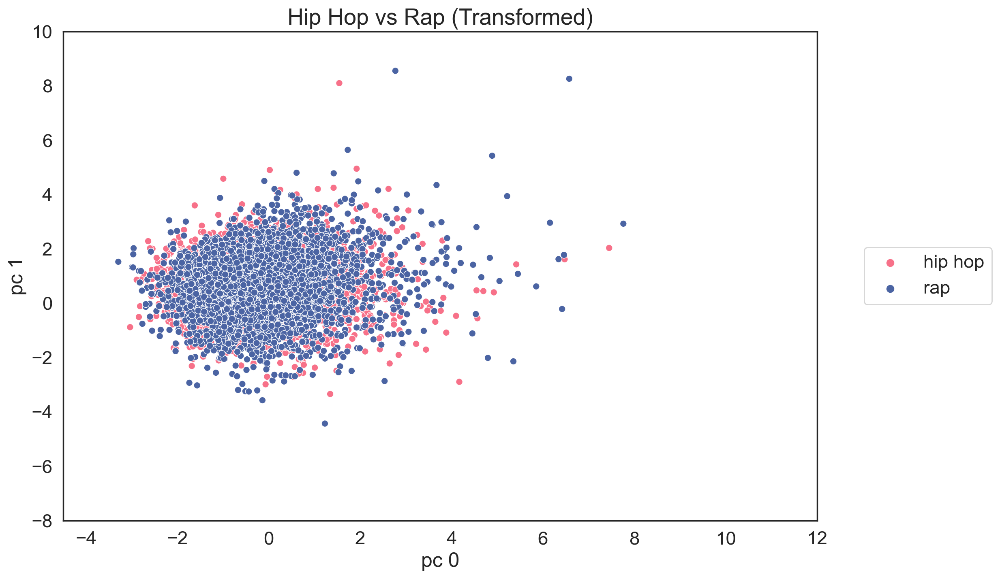

In [72]:
principalDf = pca_2d('hip hop','rap')

hue_order = ['hip hop','rap']

plt.figure(figsize=(12, 8),dpi=200)
sns.set_theme(font_scale=1.5,style='white')
ax = sns.scatterplot(x=principalDf.iloc[:, 0], y=principalDf.iloc[:, 1], hue=principalDf['genre'], palette={'hip hop':"#f77189",'rap':'#4b64a3'},hue_order=hue_order) # ,  palette=palette
ax.legend(loc='center left', bbox_to_anchor=(1.05, 0.5), ncol=1)
plt.title("Hip Hop vs Rap (Transformed)", fontsize=20)
plt.ylim([-8,10])
plt.xlim([-4.5,12])

# plt.figure(figsize=(12, 8))
# sns.scatterplot(x=principalDf.iloc[:, 0], y=principalDf.iloc[:, 1], hue=principalDf['genre'])

In [73]:
plot3d(principalDf.iloc[:, :3], 'Spread of the first 3 PC', principalDf['genre'])

13.8555 seconds


<AxesSubplot:xlabel='tsne comp. 0', ylabel='tsne comp. 1'>

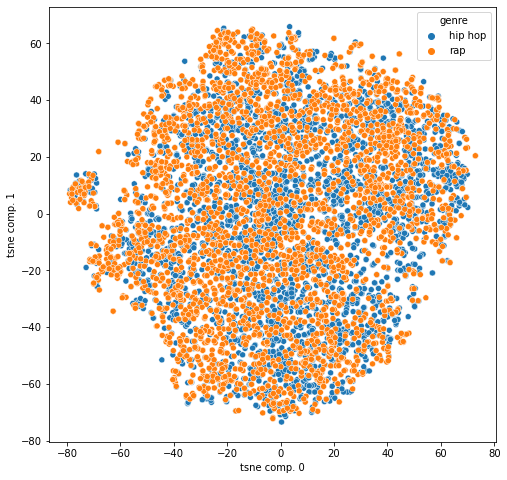

In [50]:
tsne_Df = tsne_2d('hip hop','rap',40)
plt.figure(figsize=(8, 8))
sns.scatterplot(data=tsne_Df, x='tsne comp. 0', y='tsne comp. 1', hue='genre')

## R & B
Subgenres according to the internet:
* funk
* soul

### r&b/soul vs funk

0.014 seconds
[0.20898871 0.3325267  0.43367713 0.52263439 0.60652504 0.68922418
 0.76270632 0.82787879 0.88913286 0.9417725  0.98193926 1.        ]


(-4.5, 12.0)

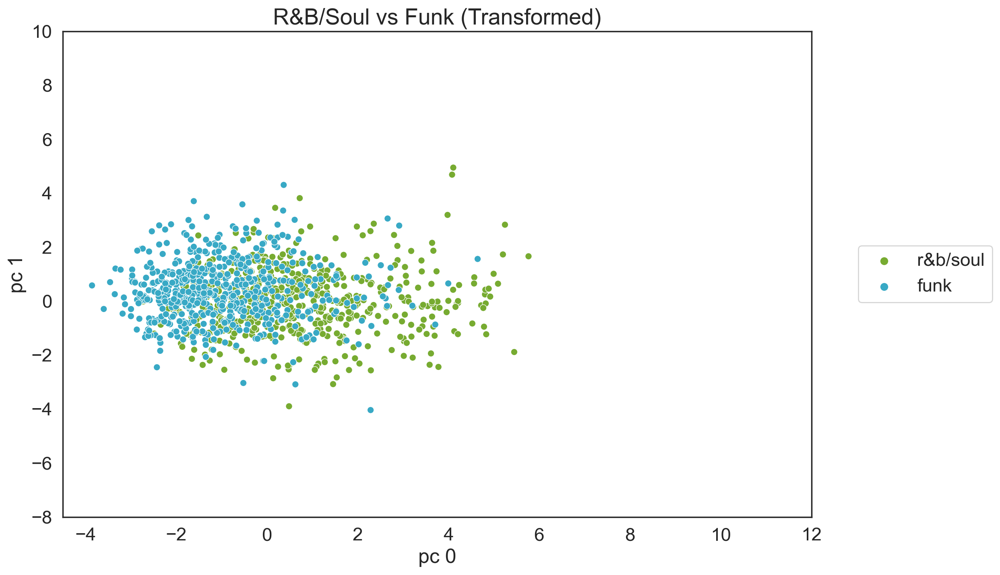

In [74]:
principalDf = pca_2d('r&b/soul','funk')

hue_order = ['r&b/soul','funk']

plt.figure(figsize=(12, 8),dpi=200)
sns.set_theme(font_scale=1.5,style='white')
ax = sns.scatterplot(x=principalDf.iloc[:, 0], y=principalDf.iloc[:, 1], hue=principalDf['genre'], palette=palette,hue_order=hue_order) # ,  palette=palette
ax.legend(loc='center left', bbox_to_anchor=(1.05, 0.5), ncol=1)
plt.title("R&B/Soul vs Funk (Transformed)", fontsize=20)
plt.ylim([-8,10])
plt.xlim([-4.5,12])

#plt.figure(figsize=(12, 8))
#sns.scatterplot(x=principalDf.iloc[:, 0], y=principalDf.iloc[:, 1], hue=principalDf['genre'])

In [52]:
plot3d(principalDf.iloc[:, :3], 'Spread of the first 3 PC', principalDf['genre'])

2.1691 seconds


<AxesSubplot:xlabel='tsne comp. 0', ylabel='tsne comp. 1'>

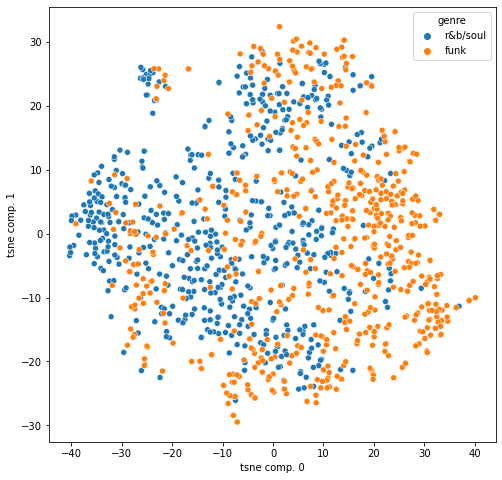

In [53]:
tsne_Df = tsne_2d('r&b/soul','funk',40)
plt.figure(figsize=(8, 8))
sns.scatterplot(data=tsne_Df, x='tsne comp. 0', y='tsne comp. 1', hue='genre')

## Dance/Electronic
Subgenres according to the internet:
* house
* trap

### dance/electronic vs house

0.013 seconds
[0.20898871 0.3325267  0.43367713 0.52263439 0.60652504 0.68922418
 0.76270632 0.82787879 0.88913286 0.9417725  0.98193926 1.        ]


(-4.5, 12.0)

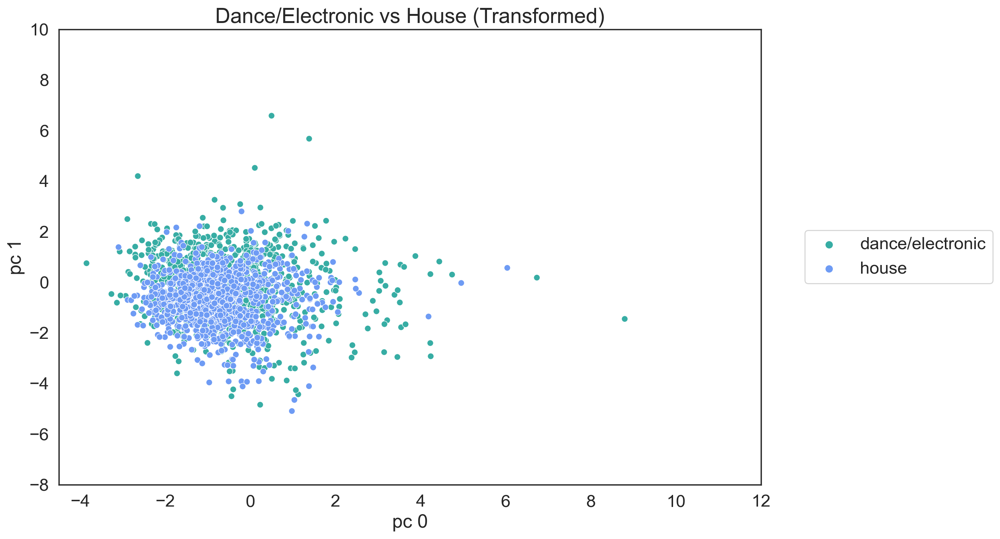

In [9]:
principalDf = pca_2d('dance/electronic','house')

hue_order = ['dance/electronic','house']

plt.figure(figsize=(12, 8),dpi=200)
sns.set_theme(font_scale=1.5,style='white')
ax = sns.scatterplot(x=principalDf.iloc[:, 0], y=principalDf.iloc[:, 1], hue=principalDf['genre'], palette=palette,hue_order=hue_order) # ,  palette=palette
ax.legend(loc='center left', bbox_to_anchor=(1.05, 0.5), ncol=1)
plt.title("Dance/Electronic vs House (Transformed)", fontsize=20)
plt.ylim([-8,10])
plt.xlim([-4.5,12])

#plt.figure(figsize=(12, 8))
#sns.scatterplot(x=principalDf.iloc[:, 0], y=principalDf.iloc[:, 1], hue=principalDf['genre'])

In [22]:
plot3d(principalDf.iloc[:, :3], 'Spread of the first 3 PC', principalDf['genre'])

4.2306 seconds


<AxesSubplot:xlabel='tsne comp. 0', ylabel='tsne comp. 1'>

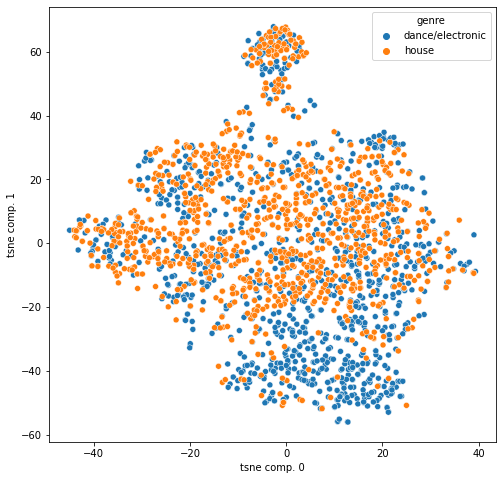

In [56]:
tsne_Df = tsne_2d('dance/electronic','house',40)
plt.figure(figsize=(8, 8))
sns.scatterplot(data=tsne_Df, x='tsne comp. 0', y='tsne comp. 1', hue='genre')

### dance/electronic vs trap

0.015 seconds
[0.20898871 0.3325267  0.43367713 0.52263439 0.60652504 0.68922418
 0.76270632 0.82787879 0.88913286 0.9417725  0.98193926 1.        ]


(-4.5, 12.0)

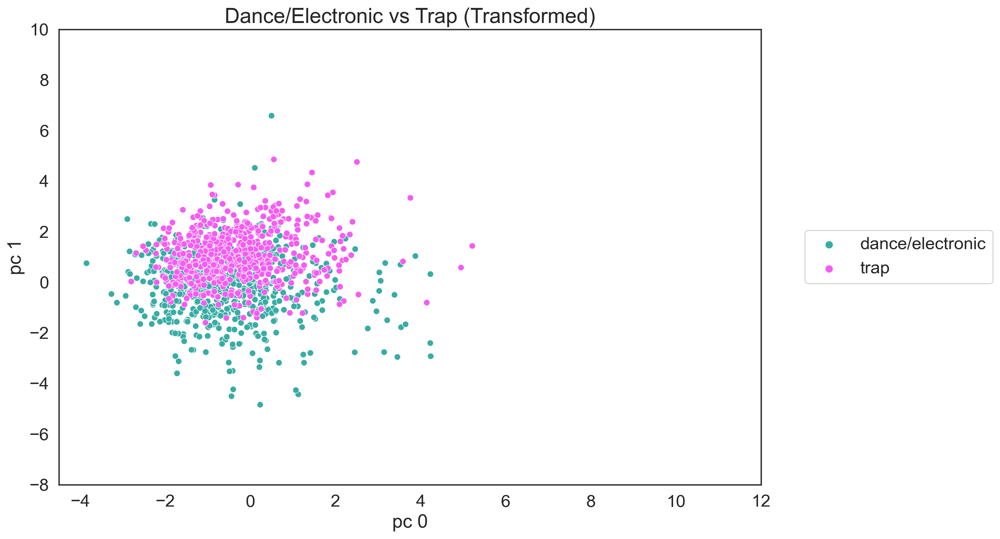

In [10]:
principalDf = pca_2d('dance/electronic','trap')

hue_order = ['dance/electronic','trap']

plt.figure(figsize=(12, 8),dpi=200)
sns.set_theme(font_scale=1.5,style='white')
ax = sns.scatterplot(x=principalDf.iloc[:, 0], y=principalDf.iloc[:, 1], hue=principalDf['genre'], palette=palette,hue_order=hue_order) # ,  palette=palette
ax.legend(loc='center left', bbox_to_anchor=(1.05, 0.5), ncol=1)
plt.title("Dance/Electronic vs Trap (Transformed)", fontsize=20)
plt.ylim([-8,10])
plt.xlim([-4.5,12])

#plt.figure(figsize=(12, 8))
#sns.scatterplot(x=principalDf.iloc[:, 0], y=principalDf.iloc[:, 1], hue=principalDf['genre'])

In [24]:
plot3d(principalDf.iloc[:, :3], 'Spread of the first 3 PC', principalDf['genre'])

2.447 seconds


<AxesSubplot:xlabel='tsne comp. 0', ylabel='tsne comp. 1'>

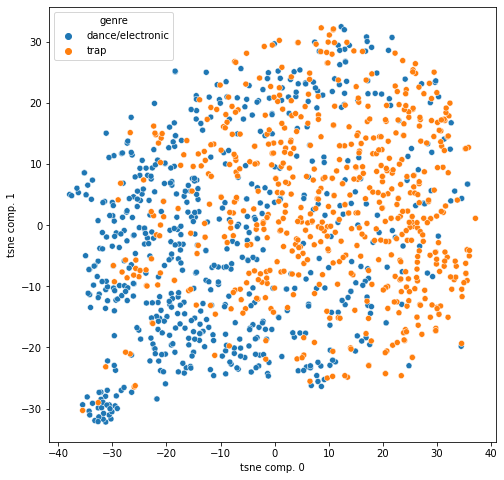

In [59]:
tsne_Df = tsne_2d('dance/electronic','trap',40)
plt.figure(figsize=(8, 8))
sns.scatterplot(data=tsne_Df, x='tsne comp. 0', y='tsne comp. 1', hue='genre')

## Reggae
Subgenres according to the internet:
* reggaeton (it is influenced by hip hop tho)

### reggae vs reggaeton

0.0129 seconds
[0.20898871 0.3325267  0.43367713 0.52263439 0.60652504 0.68922418
 0.76270632 0.82787879 0.88913286 0.9417725  0.98193926 1.        ]


(-4.5, 12.0)

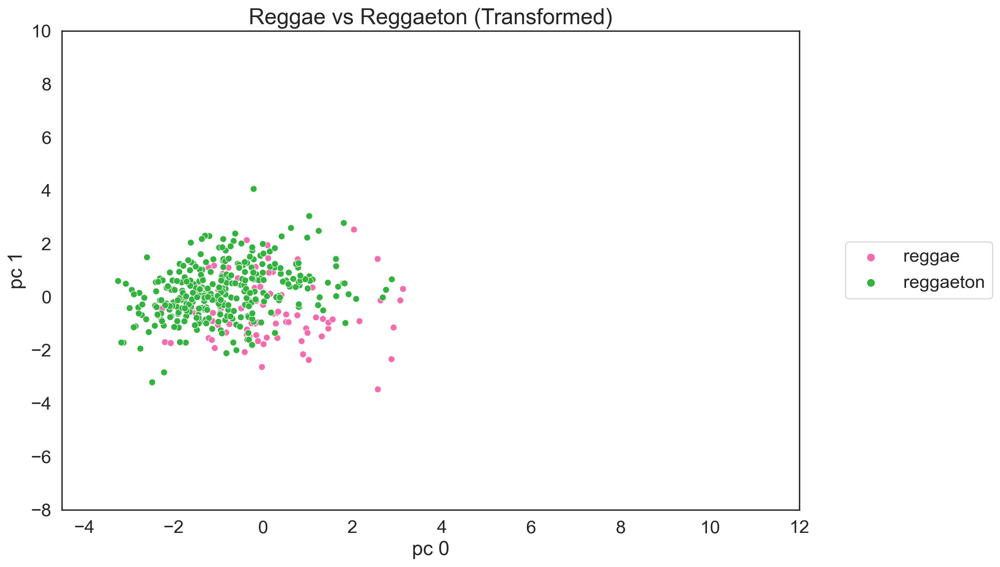

In [17]:
principalDf = pca_2d('reggae','reggaeton')

hue_order = ['reggae','reggaeton']

plt.figure(figsize=(12, 8),dpi=200)
sns.set_theme(font_scale=1.5,style='white')
ax = sns.scatterplot(x=principalDf.iloc[:, 0], y=principalDf.iloc[:, 1], hue=principalDf['genre'], palette=palette,hue_order=hue_order) # ,  palette=palette
ax.legend(loc='center left', bbox_to_anchor=(1.05, 0.5), ncol=1)
plt.title("Reggae vs Reggaeton (Transformed)", fontsize=20)
plt.ylim([-8,10])
plt.xlim([-4.5,12])

#plt.figure(figsize=(12, 8))
#sns.scatterplot(x=principalDf.iloc[:, 0], y=principalDf.iloc[:, 1], hue=principalDf['genre'])

In [26]:
plot3d(principalDf.iloc[:, :3], 'Spread of the first 3 PC', principalDf['genre'])

0.374 seconds


<AxesSubplot:xlabel='tsne comp. 0', ylabel='tsne comp. 1'>

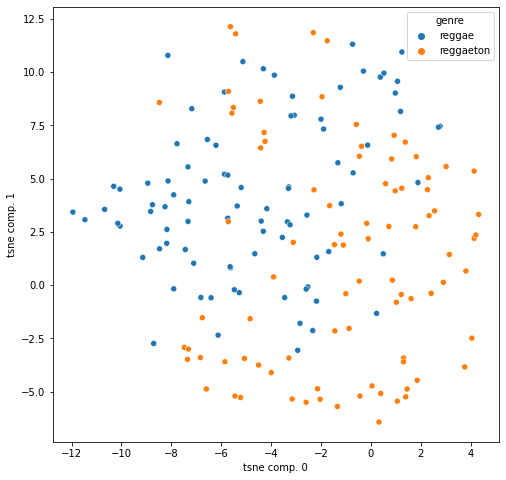

In [62]:
tsne_Df = tsne_2d('reggae','reggaeton',40)
plt.figure(figsize=(8, 8))
sns.scatterplot(data=tsne_Df, x='tsne comp. 0', y='tsne comp. 1', hue='genre')

### hip hop vs reggaeton

0.013 seconds
[0.20898871 0.3325267  0.43367713 0.52263439 0.60652504 0.68922418
 0.76270632 0.82787879 0.88913286 0.9417725  0.98193926 1.        ]


(-4.5, 12.0)

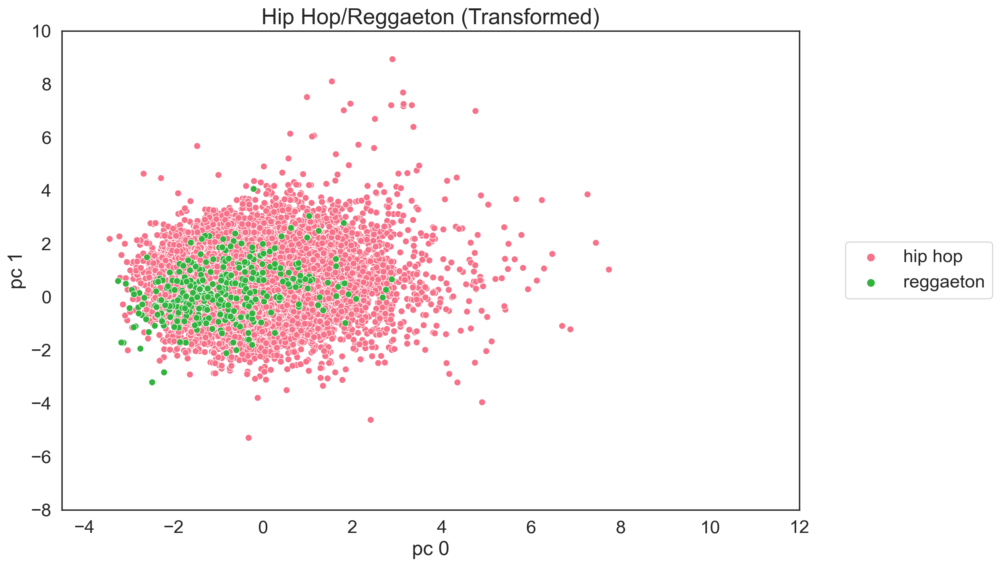

In [16]:
principalDf = pca_2d('hip hop','reggaeton')

hue_order = ['hip hop','reggaeton']

plt.figure(figsize=(12, 8),dpi=200)
sns.set_theme(font_scale=1.5,style='white')
ax = sns.scatterplot(x=principalDf.iloc[:, 0], y=principalDf.iloc[:, 1], hue=principalDf['genre'], palette=palette,hue_order=hue_order) # ,  palette=palette
ax.legend(loc='center left', bbox_to_anchor=(1.05, 0.5), ncol=1)
plt.title("Hip Hop/Reggaeton (Transformed)", fontsize=20)
plt.ylim([-8,10])
plt.xlim([-4.5,12])

#plt.figure(figsize=(12, 8))
#sns.scatterplot(x=principalDf.iloc[:, 0], y=principalDf.iloc[:, 1], hue=principalDf['genre'])

In [64]:
plot3d(principalDf.iloc[:, :3], 'Spread of the first 3 PC', principalDf['genre'])

1.1888 seconds


<AxesSubplot:xlabel='tsne comp. 0', ylabel='tsne comp. 1'>

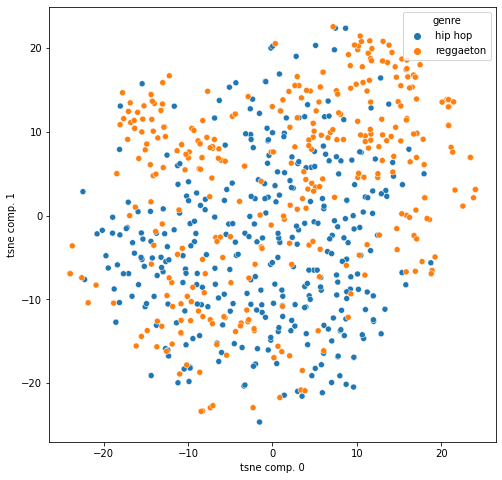

In [65]:
tsne_Df = tsne_2d('hip hop','reggaeton',40)
plt.figure(figsize=(8, 8))
sns.scatterplot(data=tsne_Df, x='tsne comp. 0', y='tsne comp. 1', hue='genre')

## Latin
Subgenres according to the internet:
* bolero

### latin vs bolero

0.014 seconds
[0.20898871 0.3325267  0.43367713 0.52263439 0.60652504 0.68922418
 0.76270632 0.82787879 0.88913286 0.9417725  0.98193926 1.        ]


(-4.5, 12.0)

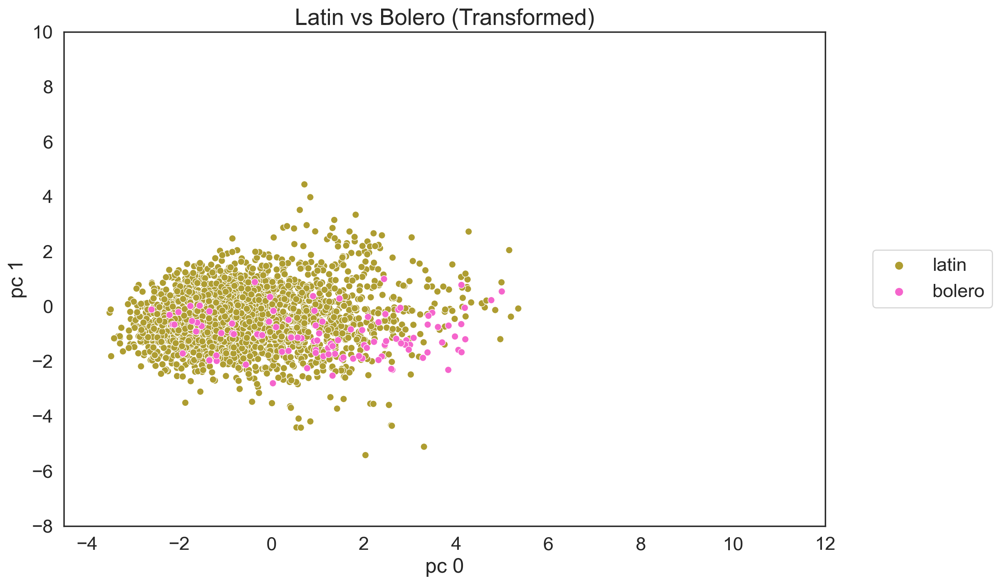

In [15]:
principalDf = pca_2d('latin','bolero')

hue_order = ['latin','bolero']

plt.figure(figsize=(12, 8),dpi=200)
sns.set_theme(font_scale=1.5,style='white')
ax = sns.scatterplot(x=principalDf.iloc[:, 0], y=principalDf.iloc[:, 1], hue=principalDf['genre'], palette=palette,hue_order=hue_order) # ,  palette=palette
ax.legend(loc='center left', bbox_to_anchor=(1.05, 0.5), ncol=1)
plt.title("Latin vs Bolero (Transformed)", fontsize=20)
plt.ylim([-8,10])
plt.xlim([-4.5,12])

#plt.figure(figsize=(12, 8))
#sns.scatterplot(x=principalDf.iloc[:, 0], y=principalDf.iloc[:, 1], hue=principalDf['genre'])

In [28]:
plot3d(principalDf.iloc[:, :3], 'Spread of the first 3 PC', principalDf['genre'])

0.4094 seconds


<AxesSubplot:xlabel='tsne comp. 0', ylabel='tsne comp. 1'>

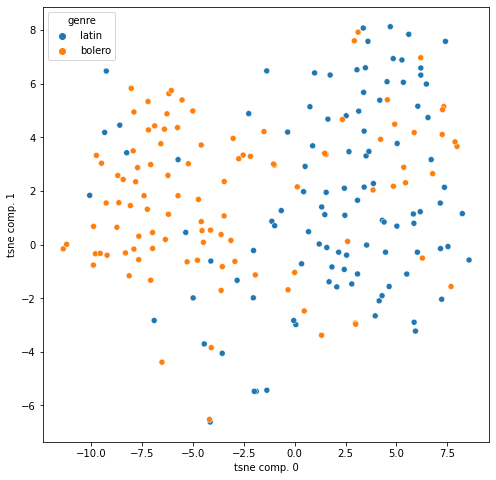

In [68]:
tsne_Df = tsne_2d('latin','bolero',40)
plt.figure(figsize=(8, 8))
sns.scatterplot(data=tsne_Df, x='tsne comp. 0', y='tsne comp. 1', hue='genre')

# Comparing the Big Ones
(Without the 'sub genres')

0.009 seconds
[0.20916576 0.33029927 0.43511577 0.52822363 0.61625294 0.69391086
 0.7623608  0.82921854 0.88905705 0.94211327 0.98220344 1.        ]


<AxesSubplot:xlabel='pc 0', ylabel='pc 1'>

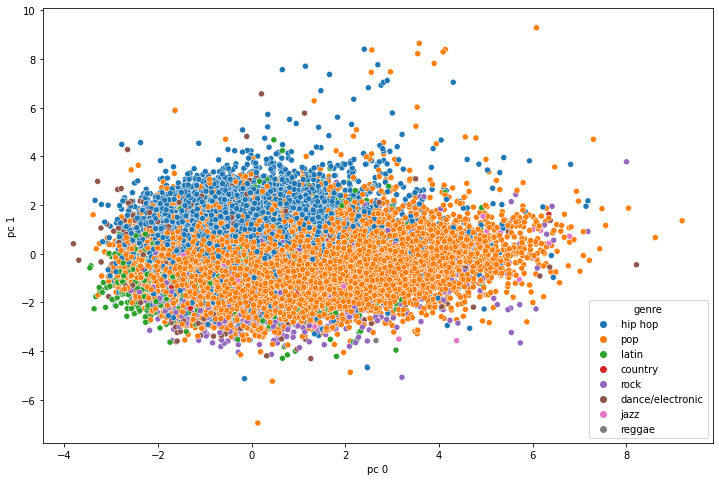

In [36]:
df=pd.read_pickle('../dataset_/transformed_dataset.pickle')
genres = ['pop','rock','latin','&b/soul','hip hop','country','dance/electronic','reggae','jazz']

###########################################################################

# PCA

num = ['popularity', 'artist_followers', 'danceability', 'energy', 'loudness', 'speechiness', 'acoustics','instrumentalness','liveness','valence','tempo', 'duration_min']
X = num # + ['artist']
y = ['genre']
df = df[X + y]
    
scaler = StandardScaler()

df[num] = scaler.fit_transform(df[num])

df = df.loc[df['genre'].isin(genres)]

###########################################################################

start = time.time()

pca = PCA()
components = pca.fit_transform(df[X])

end = time.time()
print(str(round(end - start,4)) + ' seconds')

###########################################################################

columns=[f'pc {i}' for i in range(components.shape[1])]
principalDf = pd.DataFrame(data=components, columns=columns)
principalDf.reset_index(drop=True, inplace=True)
y_val = df[y]
y_val.reset_index(drop=True, inplace=True)
principalDf= pd.concat([principalDf, y_val], axis=1)
print(pca.explained_variance_ratio_.cumsum())

plt.figure(figsize=(12, 8))
sns.scatterplot(x=principalDf.iloc[:, 0], y=principalDf.iloc[:, 1], hue=principalDf['genre'])

In [30]:
plot3d(principalDf.iloc[:, :3], 'Spread of the first 3 PC', principalDf['genre'])

140.4691 seconds


<AxesSubplot:xlabel='tsne comp. 0', ylabel='tsne comp. 1'>

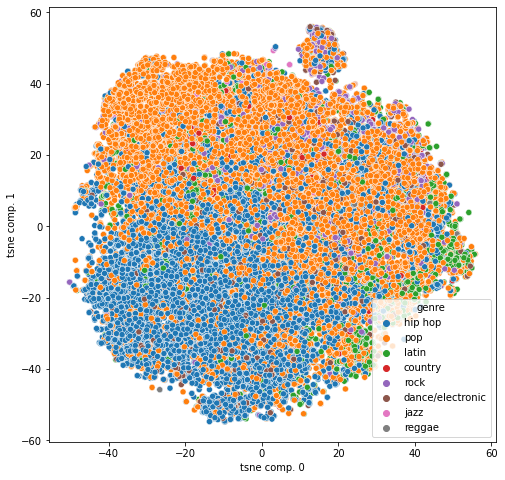

In [71]:
# TSNE

start = time.time()

tsne = TSNE(n_components=2, perplexity=40)  # perplexity=40 , perplexity=60
tsne_result = tsne.fit_transform(df[X])

end = time.time()
print(str(round(end - start,4)) + ' seconds')

###########################################################################

columns=[f'tsne comp. {i}' for i in range(tsne_result.shape[1])]
tsne_Df = pd.DataFrame(data=tsne_result, columns=columns)
tsne_Df.reset_index(drop=True, inplace=True)
y_val = df[y]
y_val.reset_index(drop=True, inplace=True)
tsne_Df = pd.concat([tsne_Df, y_val], axis=1)

plt.figure(figsize=(8, 8))
sns.scatterplot(data=tsne_Df, x='tsne comp. 0', y='tsne comp. 1', hue='genre')

## Similar Genres
Expected to be similar:
* Pop and Rock
* Pop and R&B
* Pop and Latin
* Pop and Country
* Rock and Electronic
* Rock and Hip Hop

### pop vs rock

0.013 seconds
[0.20898871 0.3325267  0.43367713 0.52263439 0.60652504 0.68922418
 0.76270632 0.82787879 0.88913286 0.9417725  0.98193926 1.        ]


(-4.5, 12.0)

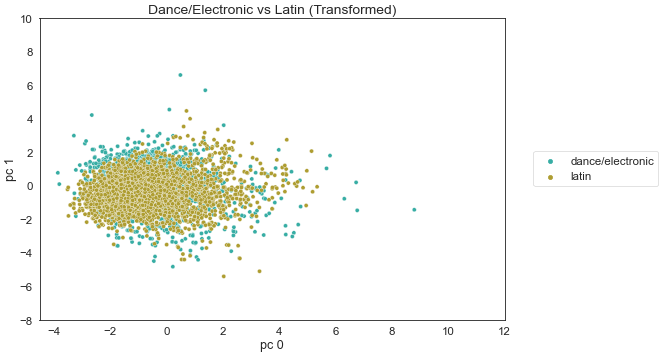

In [55]:
principalDf = pca_2d('dance/electronic','latin')

hue_order = ['dance/electronic','latin']

plt.figure(figsize=(12, 8),dpi=50)
sns.set_theme(font_scale=1.5,style='white')
ax = sns.scatterplot(x=principalDf.iloc[:, 0], y=principalDf.iloc[:, 1], hue=principalDf['genre'], palette=palette,hue_order=hue_order) # ,  palette=palette
ax.legend(loc='center left', bbox_to_anchor=(1.05, 0.5), ncol=1)
plt.title("Dance/Electronic vs Latin (Transformed)", fontsize=20)
plt.ylim([-8,10])
plt.xlim([-4.5,12])

#plt.figure(figsize=(12, 8))
#sns.scatterplot(x=principalDf.iloc[:, 0], y=principalDf.iloc[:, 1], hue=principalDf['genre'])

In [73]:
plot3d(principalDf.iloc[:, :3], 'Spread of the first 3 PC', principalDf['genre'])

7.7937 seconds


<AxesSubplot:xlabel='tsne comp. 0', ylabel='tsne comp. 1'>

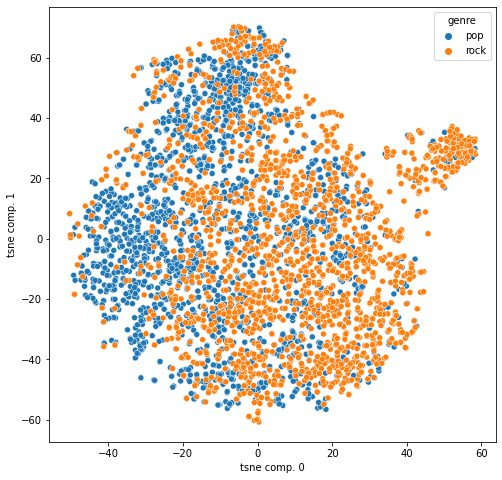

In [74]:
tsne_Df = tsne_2d('pop','rock',40)
plt.figure(figsize=(8, 8))
sns.scatterplot(data=tsne_Df, x='tsne comp. 0', y='tsne comp. 1', hue='genre')

### pop vs r&b

0.001 seconds
[0.2396007  0.35822165 0.46964068 0.55785387 0.64064485 0.71710902
 0.78532216 0.84334854 0.89778294 0.94453637 0.98246903 1.        ]


<AxesSubplot:xlabel='pc 0', ylabel='pc 1'>

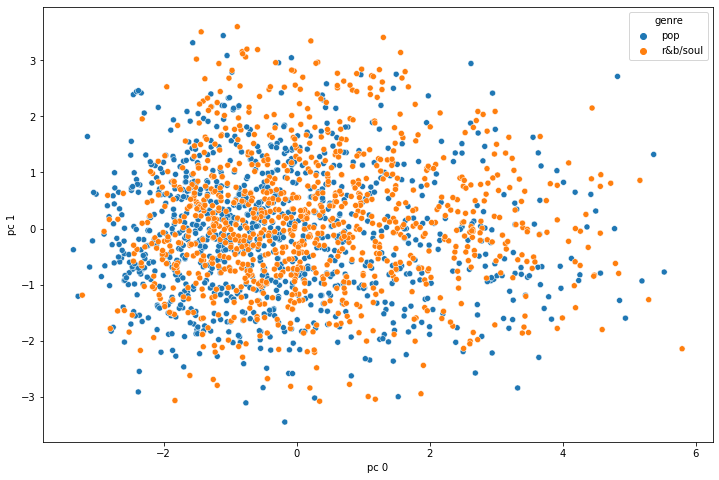

In [75]:
principalDf = pca_2d('pop','r&b/soul')

plt.figure(figsize=(12, 8))
sns.scatterplot(x=principalDf.iloc[:, 0], y=principalDf.iloc[:, 1], hue=principalDf['genre'])

In [76]:
plot3d(principalDf.iloc[:, :3], 'Spread of the first 3 PC', principalDf['genre'])

3.8242 seconds


<AxesSubplot:xlabel='tsne comp. 0', ylabel='tsne comp. 1'>

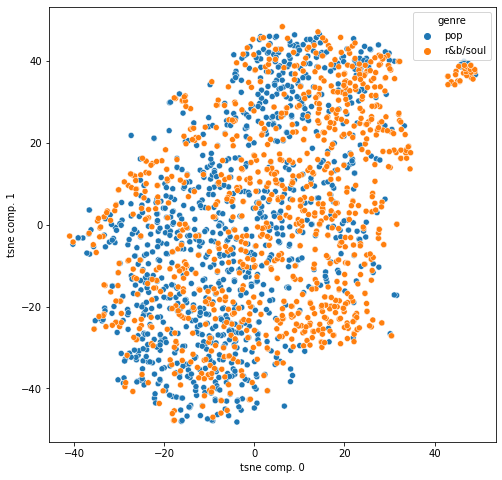

In [77]:
tsne_Df = tsne_2d('pop','r&b/soul',40)
plt.figure(figsize=(8, 8))
sns.scatterplot(data=tsne_Df, x='tsne comp. 0', y='tsne comp. 1', hue='genre')

### pop vs hip hop

0.006 seconds
[0.21281921 0.33602796 0.44206569 0.53907149 0.62868893 0.70672198
 0.77445498 0.83967868 0.89858883 0.9430593  0.98182417 1.        ]


<AxesSubplot:xlabel='pc 0', ylabel='pc 1'>

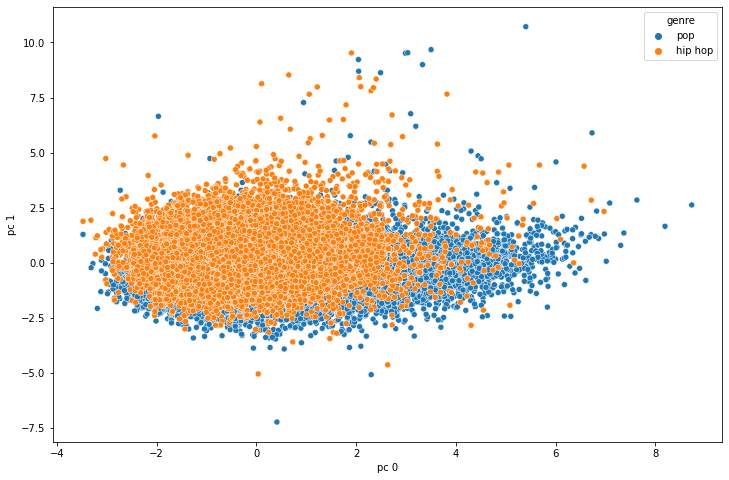

In [102]:
principalDf = pca_2d('pop','hip hop')

plt.figure(figsize=(12, 8))
sns.scatterplot(x=principalDf.iloc[:, 0], y=principalDf.iloc[:, 1], hue=principalDf['genre'])

In [103]:
plot3d(principalDf.iloc[:, :3], 'Spread of the first 3 PC', principalDf['genre'])

181.6602 seconds


<AxesSubplot:xlabel='tsne comp. 0', ylabel='tsne comp. 1'>

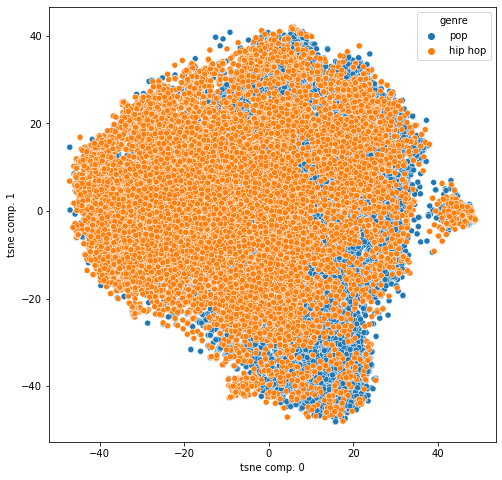

In [106]:
tsne_Df = tsne_2d('pop','hip hop',150)
plt.figure(figsize=(8, 8))
sns.scatterplot(data=tsne_Df, x='tsne comp. 0', y='tsne comp. 1', hue='genre')

### pop vs latin

0.001 seconds
[0.24125141 0.37110864 0.49420791 0.59748094 0.68698854 0.76265282
 0.82389397 0.87575505 0.91714792 0.95281733 0.98302642 1.        ]


<AxesSubplot:xlabel='pc 0', ylabel='pc 1'>

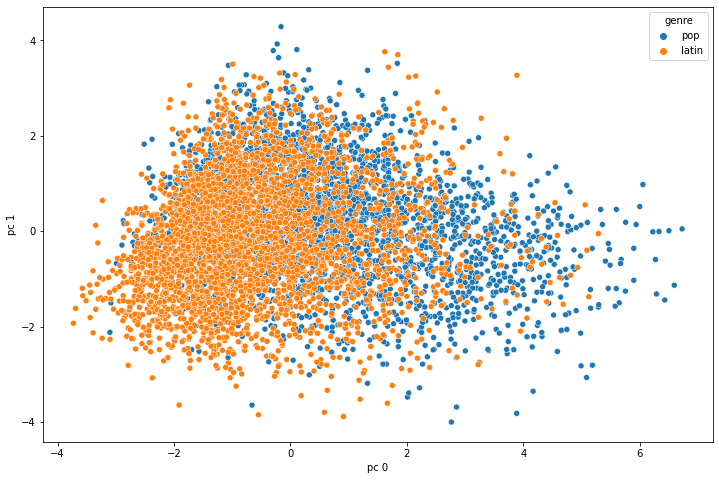

In [78]:
principalDf = pca_2d('pop','latin')

plt.figure(figsize=(12, 8))
sns.scatterplot(x=principalDf.iloc[:, 0], y=principalDf.iloc[:, 1], hue=principalDf['genre'])

In [79]:
plot3d(principalDf.iloc[:, :3], 'Spread of the first 3 PC', principalDf['genre'])

14.7171 seconds


<AxesSubplot:xlabel='tsne comp. 0', ylabel='tsne comp. 1'>

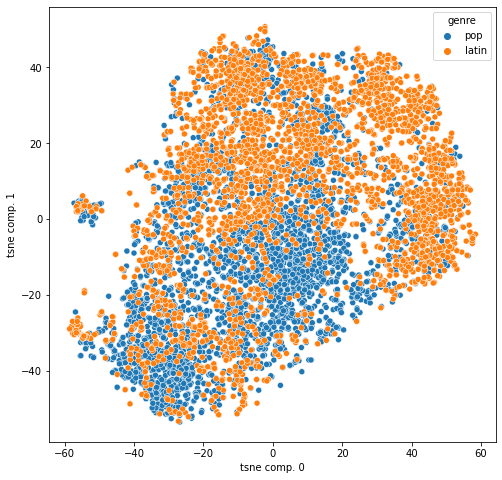

In [80]:
tsne_Df = tsne_2d('pop','latin',60)
plt.figure(figsize=(8, 8))
sns.scatterplot(data=tsne_Df, x='tsne comp. 0', y='tsne comp. 1', hue='genre')

### pop vs country

0.001 seconds
[0.30421105 0.42329912 0.53206262 0.62995063 0.7216476  0.80663153
 0.85845589 0.90681364 0.94516061 0.96815078 0.98498645 1.        ]


<AxesSubplot:xlabel='pc 0', ylabel='pc 1'>

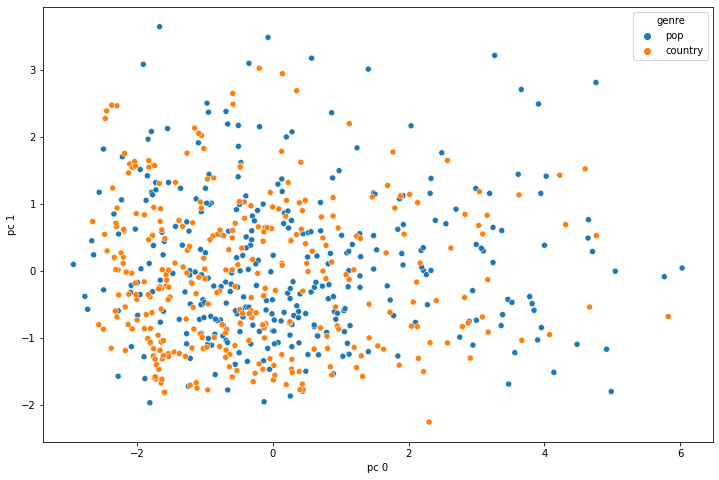

In [81]:
principalDf = pca_2d('pop','country')

plt.figure(figsize=(12, 8))
sns.scatterplot(x=principalDf.iloc[:, 0], y=principalDf.iloc[:, 1], hue=principalDf['genre'])

In [82]:
plot3d(principalDf.iloc[:, :3], 'Spread of the first 3 PC', principalDf['genre'])

1.0397 seconds


<AxesSubplot:xlabel='tsne comp. 0', ylabel='tsne comp. 1'>

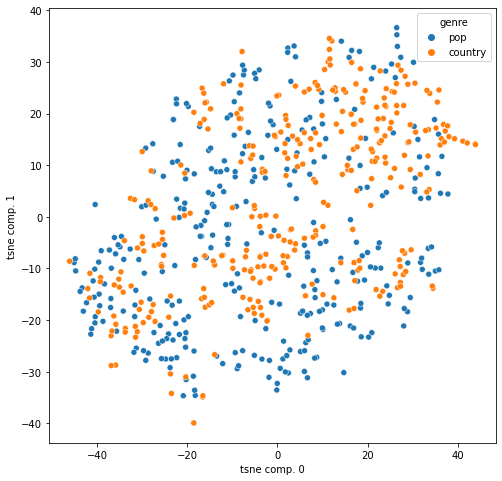

In [83]:
tsne_Df = tsne_2d('pop','country',20)
plt.figure(figsize=(8, 8))
sns.scatterplot(data=tsne_Df, x='tsne comp. 0', y='tsne comp. 1', hue='genre')

### rock vs dance/electronic

0.0169 seconds
[0.21257168 0.33549245 0.43709793 0.52599989 0.60932339 0.69147709
 0.76576745 0.83067947 0.89146254 0.94288445 0.98236381 1.        ]


(-4.0, 12.0)

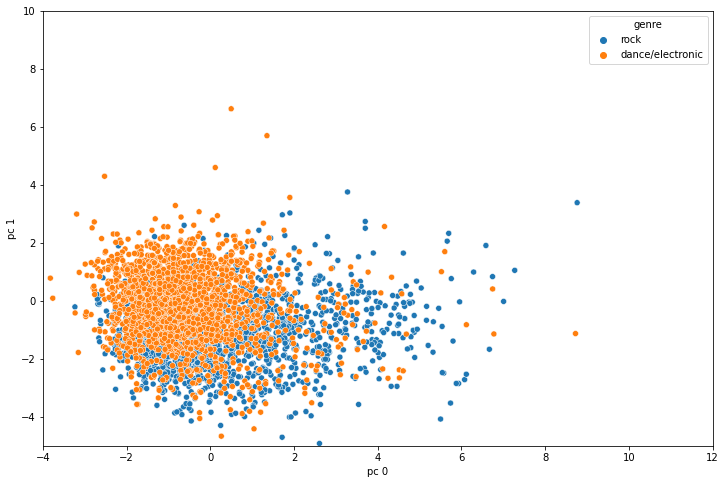

In [55]:
principalDf = pca_2d('rock','dance/electronic')

plt.figure(figsize=(12, 8))
sns.scatterplot(x=principalDf.iloc[:, 0], y=principalDf.iloc[:, 1], hue=principalDf['genre'])
plt.ylim([-5,10])
plt.xlim([-4,12])

In [85]:
plot3d(principalDf.iloc[:, :3], 'Spread of the first 3 PC', principalDf['genre'])

6.8083 seconds


<AxesSubplot:xlabel='tsne comp. 0', ylabel='tsne comp. 1'>

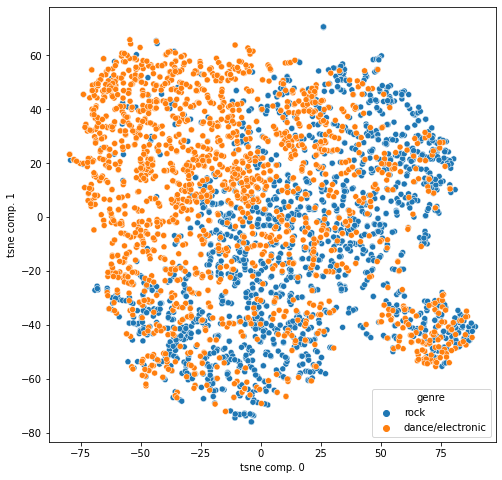

In [86]:
tsne_Df = tsne_2d('rock','dance/electronic',20)
plt.figure(figsize=(8, 8))
sns.scatterplot(data=tsne_Df, x='tsne comp. 0', y='tsne comp. 1', hue='genre')

### rock vs hip hop

0.016 seconds
[0.21257168 0.33549245 0.43709793 0.52599989 0.60932339 0.69147709
 0.76576745 0.83067947 0.89146254 0.94288445 0.98236381 1.        ]


(-4.0, 12.0)

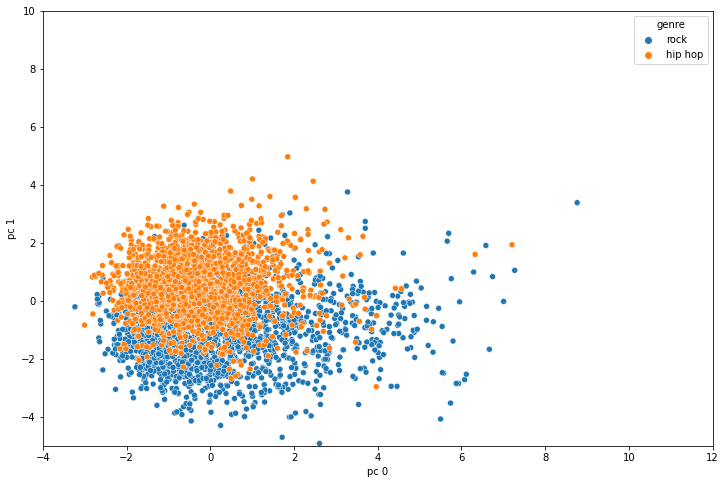

In [54]:
principalDf = pca_2d('rock','hip hop')

plt.figure(figsize=(12, 8))
sns.scatterplot(x=principalDf.iloc[:, 0], y=principalDf.iloc[:, 1], hue=principalDf['genre'])
plt.ylim([-5,10])
plt.xlim([-4,12])

In [88]:
plot3d(principalDf.iloc[:, :3], 'Spread of the first 3 PC', principalDf['genre'])

7.3615 seconds


<AxesSubplot:xlabel='tsne comp. 0', ylabel='tsne comp. 1'>

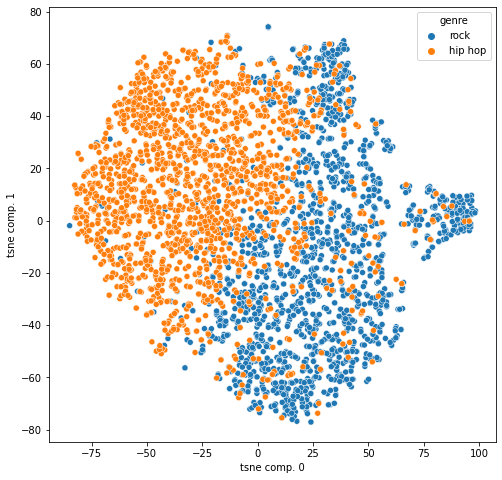

In [89]:
tsne_Df = tsne_2d('rock','hip hop',20)
plt.figure(figsize=(8, 8))
sns.scatterplot(data=tsne_Df, x='tsne comp. 0', y='tsne comp. 1', hue='genre')

## Less Similar Genres
Expected to be not as similar:
* Latin and Rock
* Latin and Hip Hop
* R&B and Hip Hop
* R&B and Rock

### latin vs rock

0.017 seconds
[0.21257168 0.33549245 0.43709793 0.52599989 0.60932339 0.69147709
 0.76576745 0.83067947 0.89146254 0.94288445 0.98236381 1.        ]


(-4.0, 12.0)

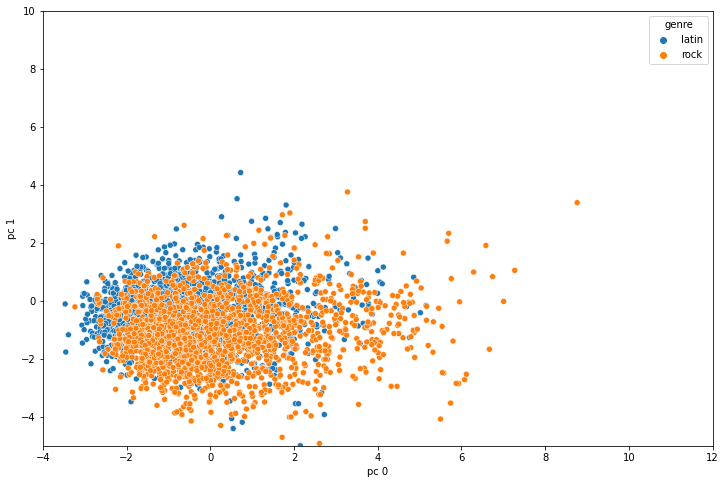

In [52]:
principalDf = pca_2d('latin','rock')

plt.figure(figsize=(12, 8))
sns.scatterplot(x=principalDf.iloc[:, 0], y=principalDf.iloc[:, 1], hue=principalDf['genre'])
plt.ylim([-5,10])
plt.xlim([-4,12])

In [91]:
plot3d(principalDf.iloc[:, :3], 'Spread of the first 3 PC', principalDf['genre'])

7.1329 seconds


<AxesSubplot:xlabel='tsne comp. 0', ylabel='tsne comp. 1'>

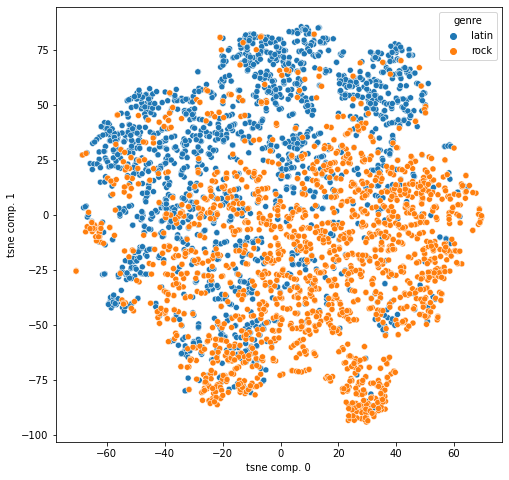

In [92]:
tsne_Df = tsne_2d('latin','rock',20)
plt.figure(figsize=(8, 8))
sns.scatterplot(data=tsne_Df, x='tsne comp. 0', y='tsne comp. 1', hue='genre')

### latin vs hip hop

0.017 seconds
[0.21257168 0.33549245 0.43709793 0.52599989 0.60932339 0.69147709
 0.76576745 0.83067947 0.89146254 0.94288445 0.98236381 1.        ]


(-4.0, 12.0)

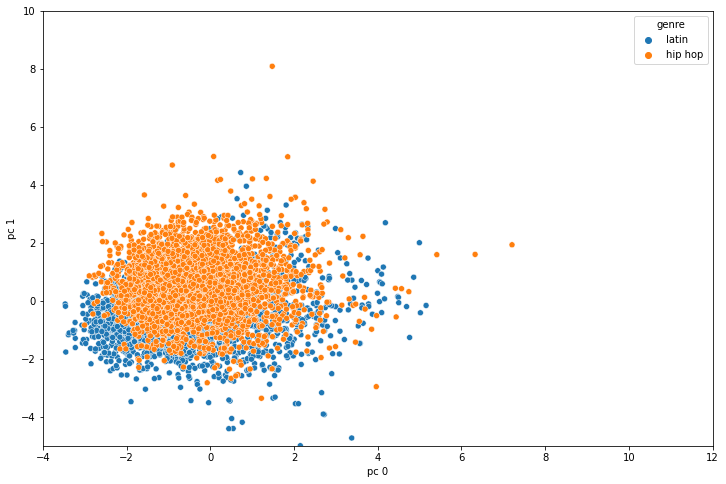

In [51]:
principalDf = pca_2d('latin','hip hop')

plt.figure(figsize=(12, 8))
sns.scatterplot(x=principalDf.iloc[:, 0], y=principalDf.iloc[:, 1], hue=principalDf['genre'])
plt.ylim([-5,10])
plt.xlim([-4,12])

In [94]:
plot3d(principalDf.iloc[:, :3], 'Spread of the first 3 PC', principalDf['genre'])

12.5003 seconds


<AxesSubplot:xlabel='tsne comp. 0', ylabel='tsne comp. 1'>

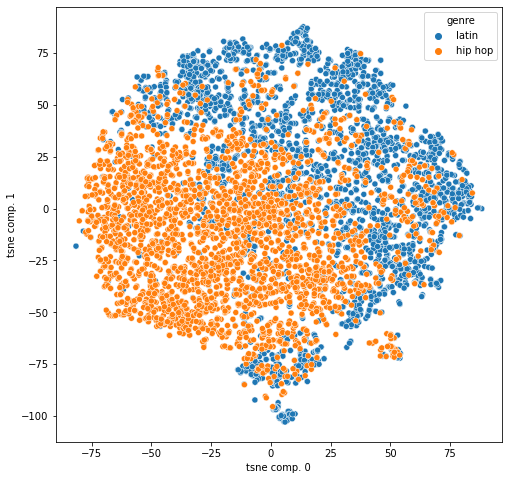

In [95]:
tsne_Df = tsne_2d('latin','hip hop',20)
plt.figure(figsize=(8, 8))
sns.scatterplot(data=tsne_Df, x='tsne comp. 0', y='tsne comp. 1', hue='genre')

### r&b vs hip hop

0.0189 seconds
[0.21257168 0.33549245 0.43709793 0.52599989 0.60932339 0.69147709
 0.76576745 0.83067947 0.89146254 0.94288445 0.98236381 1.        ]


(-4.0, 12.0)

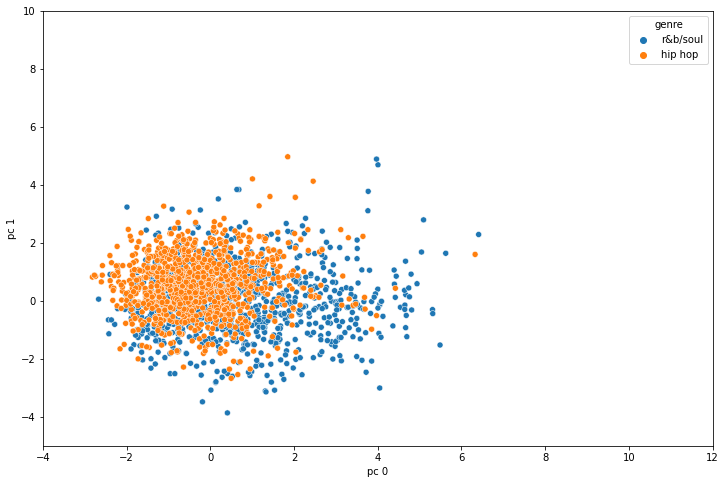

In [50]:
principalDf = pca_2d('r&b/soul','hip hop')

plt.figure(figsize=(12, 8))
sns.scatterplot(x=principalDf.iloc[:, 0], y=principalDf.iloc[:, 1], hue=principalDf['genre'])
plt.ylim([-5,10])
plt.xlim([-4,12])

In [97]:
plot3d(principalDf.iloc[:, :3], 'Spread of the first 3 PC', principalDf['genre'])

3.3807 seconds


<AxesSubplot:xlabel='tsne comp. 0', ylabel='tsne comp. 1'>

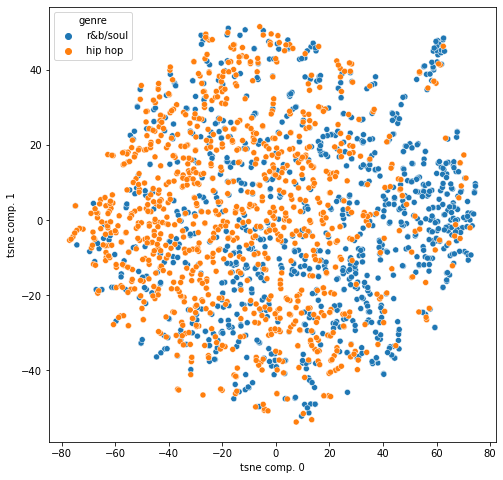

In [98]:
tsne_Df = tsne_2d('r&b/soul','hip hop',20)
plt.figure(figsize=(8, 8))
sns.scatterplot(data=tsne_Df, x='tsne comp. 0', y='tsne comp. 1', hue='genre')

### r&b vs rock

0.018 seconds
[0.21257168 0.33549245 0.43709793 0.52599989 0.60932339 0.69147709
 0.76576745 0.83067947 0.89146254 0.94288445 0.98236381 1.        ]


(-4.0, 12.0)

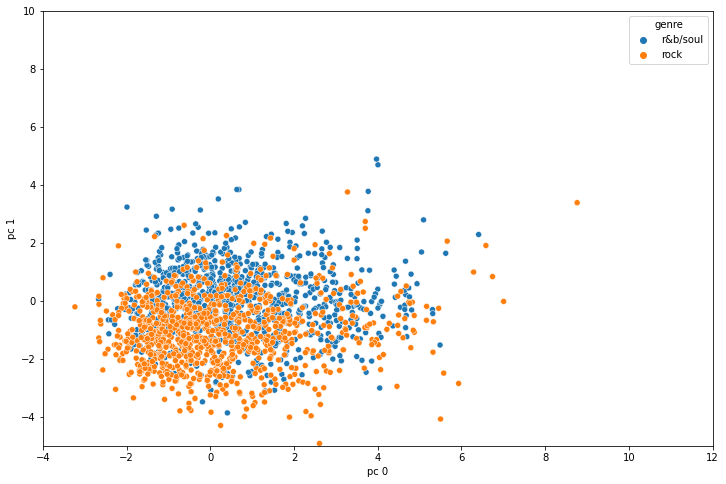

In [49]:
principalDf = pca_2d('r&b/soul','rock')

plt.figure(figsize=(12, 8))
sns.scatterplot(x=principalDf.iloc[:, 0], y=principalDf.iloc[:, 1], hue=principalDf['genre'])
plt.ylim([-5,10])
plt.xlim([-4,12])

In [100]:
plot3d(principalDf.iloc[:, :3], 'Spread of the first 3 PC', principalDf['genre'])

3.2777 seconds


<AxesSubplot:xlabel='tsne comp. 0', ylabel='tsne comp. 1'>

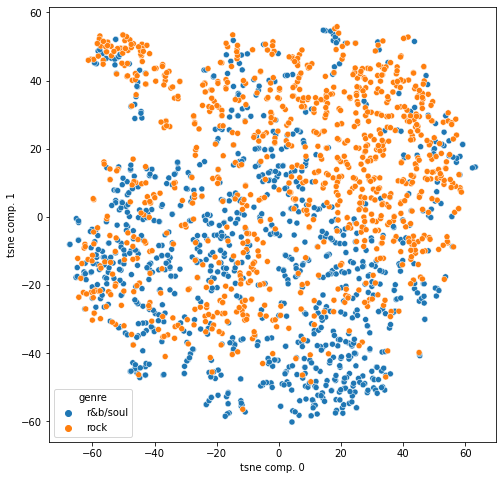

In [101]:
tsne_Df = tsne_2d('r&b/soul','rock',20)
plt.figure(figsize=(8, 8))
sns.scatterplot(data=tsne_Df, x='tsne comp. 0', y='tsne comp. 1', hue='genre')

## Subplots

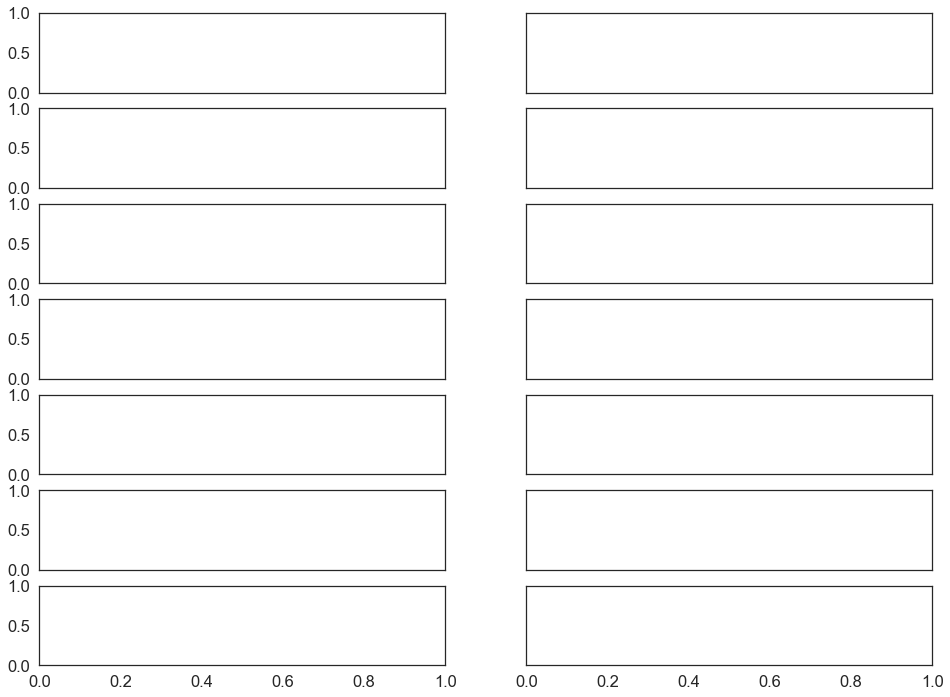

In [23]:
# fig, axs = plt.subplots(7,2,sharex=True,figsize=(16,12),sharey=True)

# 09.07.2022

## Subgenre PCA
* Pop
* Hip Hop
* Rock
* Metal
* Latin

In [53]:
def filter_features(df,X,y):
    df = df[X + y]
    return df
    
def get_scaled_genre_df(genre,X,y,num):
    df = pd.read_pickle('../dataset_/transformed_dataset.pickle')
    df = scale_num(df,num) 
    df = df[df['genre'] == genre]
    df = filter_features(df,X,y)
    return df

def reduce_to_top_subgenres(df):
    subgenres_count = len(df['sub_genre'].value_counts().index)
    print(df['sub_genre'].value_counts().head(min(5,subgenres_count)))
    print()
    top_subgenres = df['sub_genre'].value_counts().head(min(5,subgenres_count)).index
    df = df.loc[df['sub_genre'].isin(top_subgenres)]
    return df

def scale_num(df,num):
    scaler = StandardScaler()
    df[num] = scaler.fit_transform(df[num])
    return df
    
def prepare_df(genre,X,y,num):
    df = get_scaled_genre_df(genre,X,y,num)
    df = reduce_to_top_subgenres(df)
    return df

def get_pca_and_components(df,X):
    pca = PCA()
    components = pca.fit_transform(df[X])
    return pca, components

def create_principal_df(df,components,y):
    columns = [f'pc {i}' for i in range(components.shape[1])]
    principal_df = pd.DataFrame(data=components, columns=columns)
    principal_df.reset_index(drop=True,inplace=True)
    y_col = df[y]
    y_col.reset_index(drop=True,inplace=True)
    principal_df = pd.concat([principal_df,y_col],axis=1)
    return principal_df

def print_pca_information(pca):
    ratio = pca.explained_variance_ratio_
    print('Explained Variance Ratio: ')
    print(ratio)
    print()
    print('Explained Variance Ratio Cumulative Sum: ')
    print(ratio.cumsum())
    
def subgenre_pca_scatterplot(principal_df,genre):
    plt.figure(figsize=(12, 8),dpi=50)
    sns.set_theme(font_scale=1.5,style='white')
    ax = sns.scatterplot(x=principal_df.iloc[:, 0], y=principal_df.iloc[:, 1], hue=principal_df['sub_genre'])
    ax.legend(loc='center left', bbox_to_anchor=(1.05, 0.5), ncol=1)
    plt.title(genre.title() + " Subgenres (Transformed)", fontsize=20)
    plt.ylim([-8,10])
    plt.xlim([-4.5,12])
    plt.show()
    
def subgenre_pca(genre):
    num = ['popularity', 'artist_followers', 'danceability', 'energy', 'loudness', 'speechiness', 'acoustics','instrumentalness','liveness','valence','tempo', 'duration_min']
    cat = []
    X = num + cat
    y = ['sub_genre']
    df = prepare_df(genre,X,y,num)
    
    pca, components = get_pca_and_components(df,X)
    print_pca_information(pca)
    
    principal_df = create_principal_df(df,components,y)
    subgenre_pca_scatterplot(principal_df,genre)
    
    # plot3d(principal_df.iloc[:, :3], 'Spread of the first 3 PC', principal_df['sub_genre'])

### Pop

Explained Variance Ratio: 
[0.2843952  0.11788252 0.10781281 0.08730229 0.08399421 0.07646723
 0.05870475 0.05217967 0.04640064 0.03701629 0.03122057 0.0166238 ]

Explained Variance Ratio Cumulative Sum: 
[0.2843952  0.40227772 0.51009053 0.59739282 0.68138704 0.75785426
 0.81655902 0.86873869 0.91513933 0.95215563 0.9833762  1.        ]
dance pop            2868
finnish dance pop    2138
mandopop              962
pop                   769
italian adult pop     591
Name: sub_genre, dtype: int64



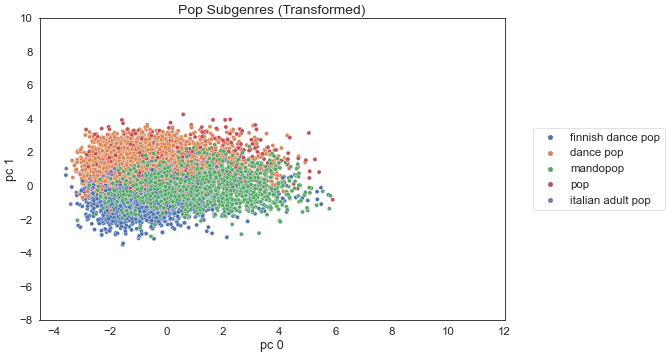

In [54]:
subgenre_pca('pop')

## Hip Hop

Explained Variance Ratio: 
[0.1438343  0.12984073 0.12185268 0.10590167 0.09805897 0.09106747
 0.07950786 0.06938731 0.05708052 0.04569108 0.03874409 0.01903332]

Explained Variance Ratio Cumulative Sum: 
[0.1438343  0.27367503 0.39552771 0.50142939 0.59948835 0.69055583
 0.77006368 0.83945099 0.89653151 0.94222259 0.98096668 1.        ]
dutch hip hop      2737
italian hip hop    1835
german hip hop     1586
polish hip hop     1342
french hip hop     1310
Name: sub_genre, dtype: int64



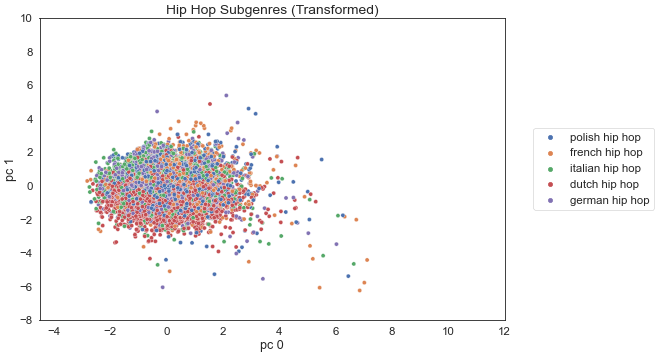

In [55]:
subgenre_pca('hip hop')

### Rock

Explained Variance Ratio: 
[0.2793738  0.1822386  0.10866004 0.0816373  0.07377927 0.0678997
 0.06477565 0.04400268 0.0390279  0.03109195 0.01749795 0.01001517]

Explained Variance Ratio Cumulative Sum: 
[0.2793738  0.4616124  0.57027243 0.65190974 0.72568901 0.79358871
 0.85836436 0.90236704 0.94139494 0.97248689 0.98998483 1.        ]
modern rock                209
album rock                 187
argentine rock             149
modern alternative rock    140
alternative rock           128
Name: sub_genre, dtype: int64



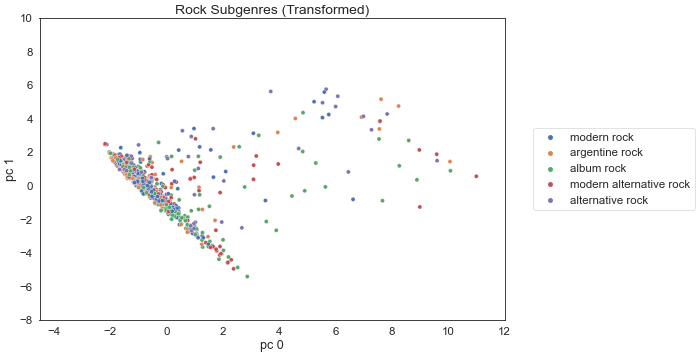

In [56]:
subgenre_pca('rock')

Explained Variance Ratio: 
[0.43457156 0.12206847 0.10551791 0.07783247 0.0699592  0.0589593
 0.04221719 0.03241226 0.02109287 0.01673764 0.01047195 0.00815919]

Explained Variance Ratio Cumulative Sum: 
[0.43457156 0.55664003 0.66215794 0.73999041 0.80994961 0.8689089
 0.91112609 0.94353835 0.96463122 0.98136886 0.99184081 1.        ]
alternative metal      316
finnish metal           52
finnish heavy metal     45
cyber metal             32
melodic metalcore       30
Name: sub_genre, dtype: int64



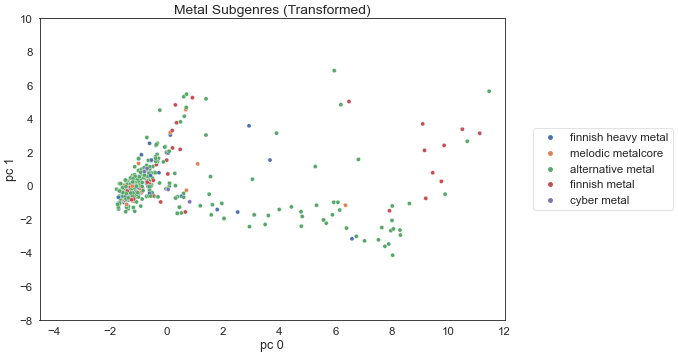

In [57]:
subgenre_pca('metal')

Explained Variance Ratio: 
[0.19715186 0.16327182 0.13072792 0.12214067 0.09357581 0.06818231
 0.05775806 0.05015489 0.03811674 0.033247   0.02790514 0.01776777]

Explained Variance Ratio Cumulative Sum: 
[0.19715186 0.36042368 0.4911516  0.61329227 0.70686809 0.7750504
 0.83280846 0.88296335 0.92108009 0.95432709 0.98223223 1.        ]
latin                1577
sertanejo             417
latin talent show     208
forro                 112
corrido               110
Name: sub_genre, dtype: int64



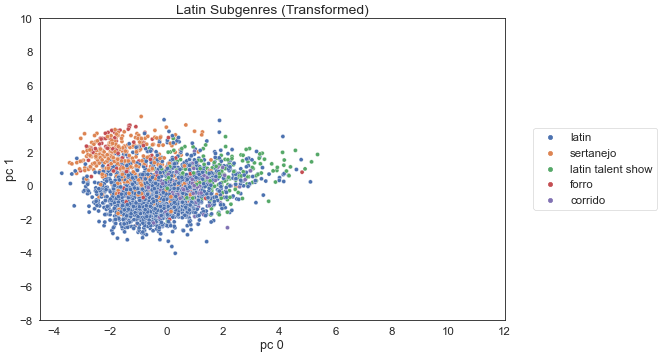

In [58]:
subgenre_pca('latin')

In [59]:
# ehm = pd.read_csv('C:\Users\Isabe\Downloads\tcc_ceds_music.csv')